In [9]:
# general
import numpy as np
from numpy.random import PCG64, SeedSequence
import pandas as pd
import verde as vd
import xarray as xr
import skgstat as skg
from skgstat import models
import gstatsim as gsm
from scipy.interpolate import RBFInterpolator
from scipy.stats import qmc
from sklearn.preprocessing import QuantileTransformer
from tqdm.auto import tqdm
import multiprocessing as mp
import cartopy.crs as ccrs
import geopandas as gpd
from pyproj import Transformer

# plotting
import matplotlib.pyplot as plt
from cmcrameri import cm

# io
from tqdm.auto import tqdm
import os
from pathlib import Path
import time
import numbers
from copy import deepcopy
import warnings
warnings.filterwarnings("ignore")

import sys
sys.path.append('..')

import gstatsim_custom as gsim

In [10]:
ds = xr.open_dataset(Path('processed_data/bedmap3_mod_1000.nc'))

# exposed_rock_cond = np.full(ds.thick_cond.shape, np.nan)
# exposed_rock_cond[ds.mask == 4] = True
thick_cond = np.where(ds.mask == 4, 0, ds.thick_cond.values)
#ground_ice_msk = ds.mask==1

bed_cond = ds.surface_topography.values - thick_cond
ice_rock_msk = (ds.mask == 1) | (ds.mask == 4) | (ds.mask == 2)
bed_cond = np.where(ice_rock_msk, bed_cond, np.nan)
xx, yy = np.meshgrid(ds.x, ds.y)

cond_msk = ~np.isnan(bed_cond)
#cond_msk = np.where(
x_cond = xx[cond_msk]
y_cond = yy[cond_msk]
data_cond = bed_cond[cond_msk]
trend = ds.trend.values

res_cond = bed_cond - trend

In [3]:
print(f'{np.count_nonzero(~np.isnan(bed_cond))/bed_cond.size*100:.3f} percent of the conditioning grid is not NaN') 

3.925 percent of the conditioning grid is not NaN


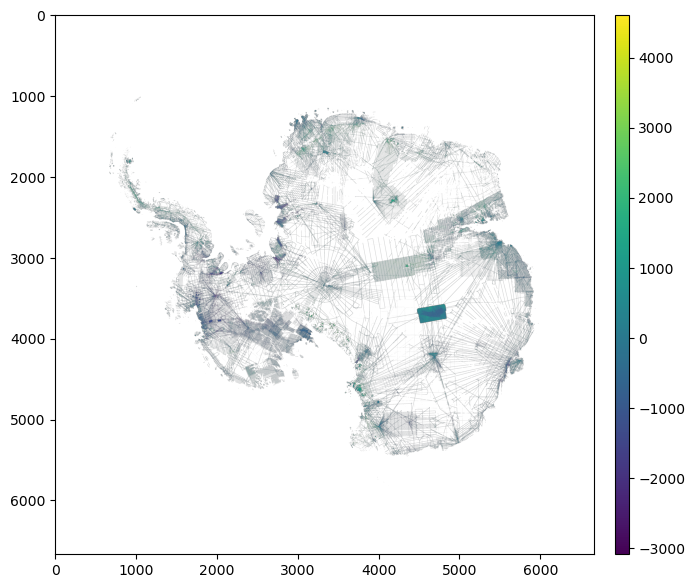

In [4]:
plt.figure(figsize=(9,7))
plt.imshow(bed_cond)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

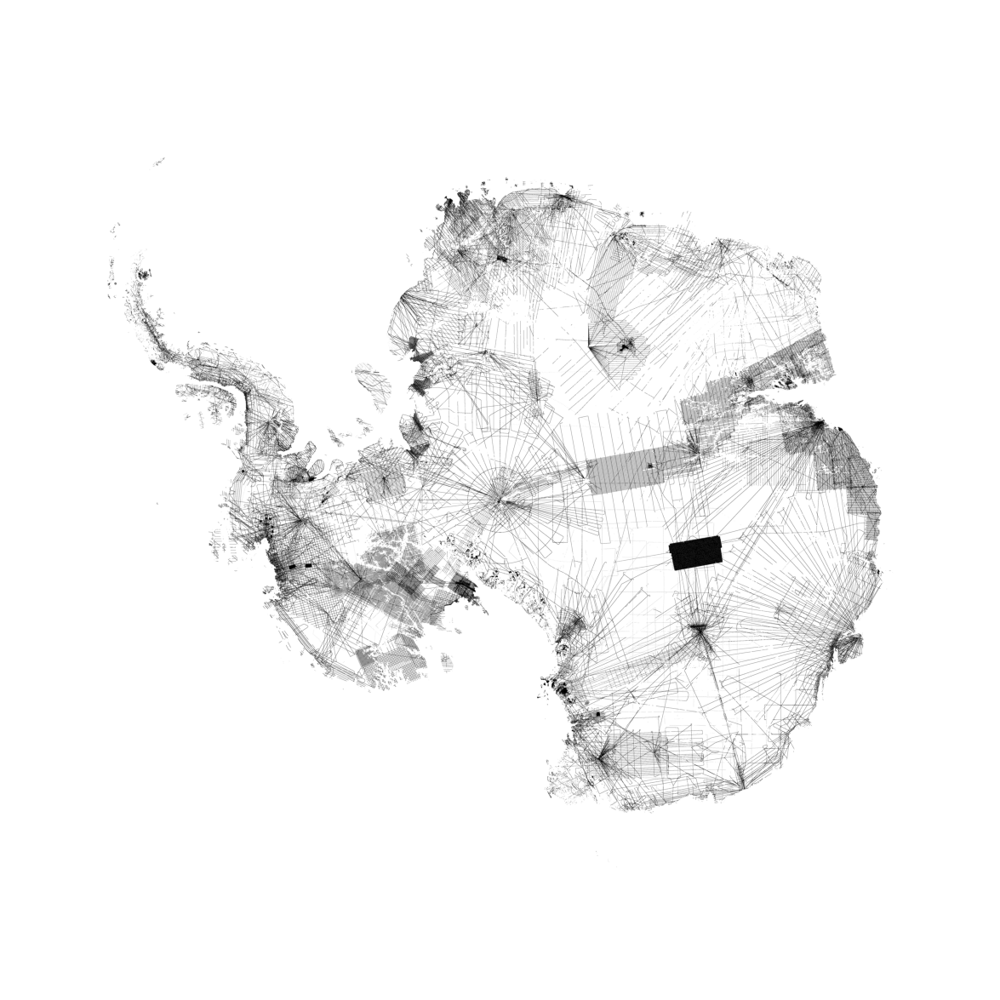

In [5]:
plt.figure(figsize=(15,15))
plt.imshow(cond_msk, cmap='binary')
plt.axis('off')
plt.savefig(Path('figures/binary_condmask.png'), dpi=300, bbox_inches='tight')
plt.show()

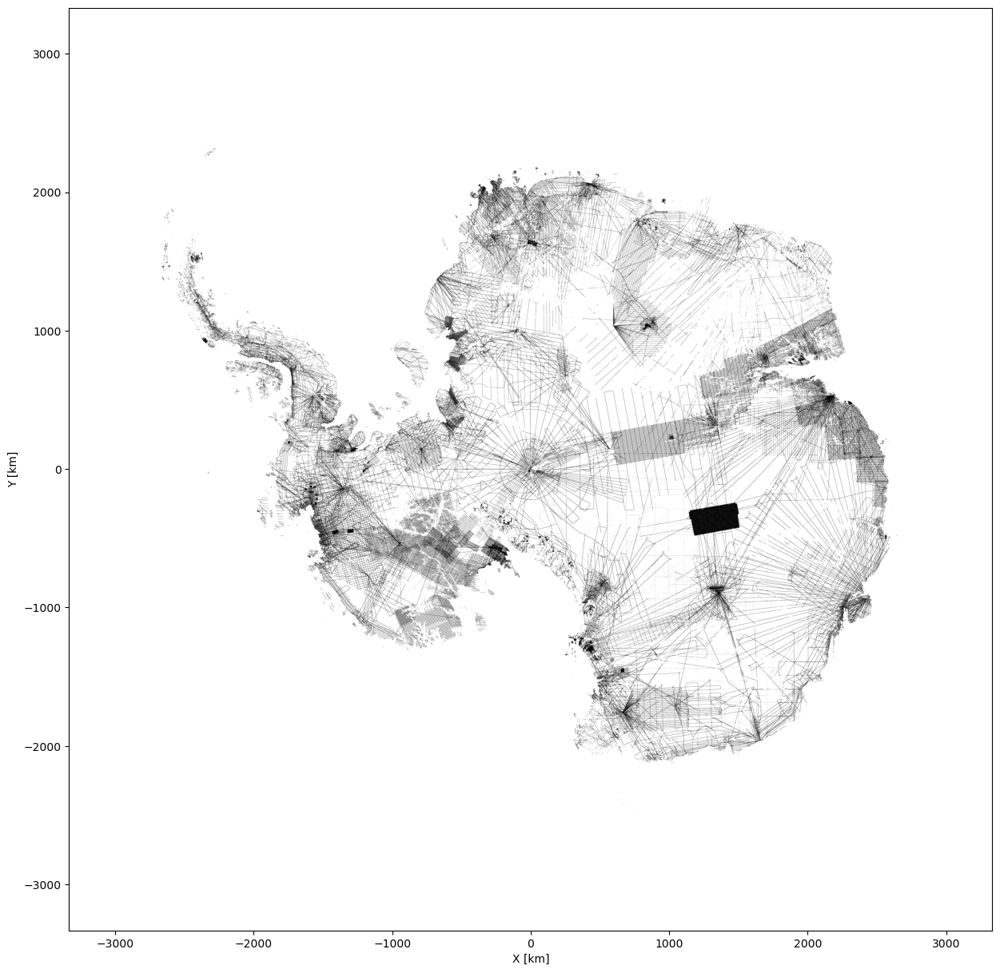

In [8]:
plt.figure(figsize=(15,15))
plt.imshow(cond_msk, cmap='binary', extent=[ds.x.values.min()/1000, ds.x.values.max()/1000, ds.y.values.min()/1000, ds.y.values.max()/1000])
plt.axis('on')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.savefig(Path('figures/binary_condmask_axes.png'), dpi=300, bbox_inches='tight')
plt.show()

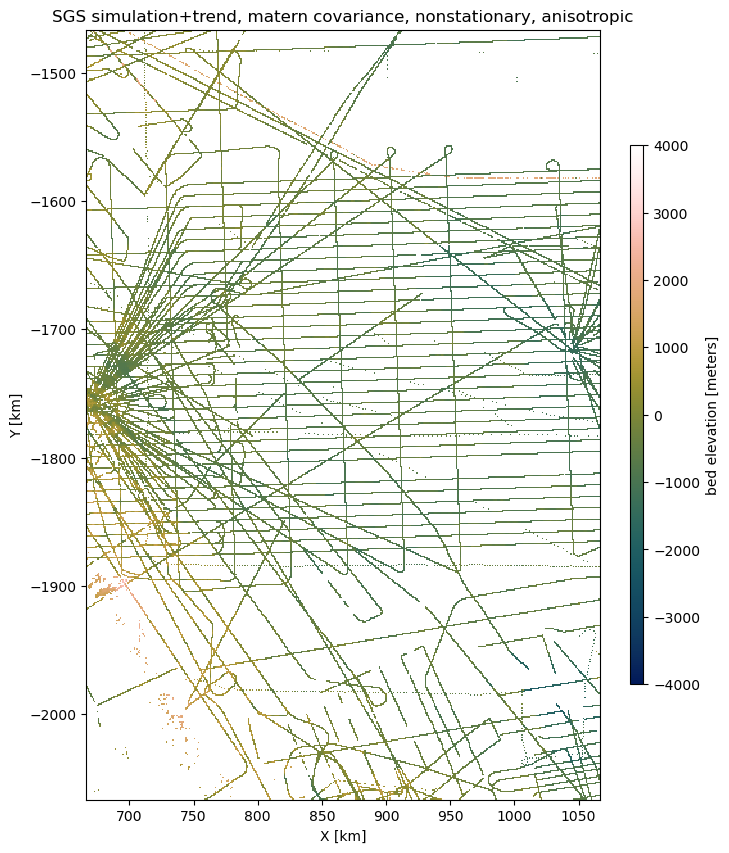

In [17]:
# ilow = 4000
# ihigh = 5600
# jlow = 3200
# jhigh = 5800

ilow = 4800
ihigh = 5400
jlow = 4000
jhigh = 4400

xx_trim = xx[ilow:ihigh,jlow:jhigh]
yy_trim = yy[ilow:ihigh,jlow:jhigh]
sim_trim = sim[ilow:ihigh,jlow:jhigh]
trend_trim = trend[ilow:ihigh,jlow:jhigh]
bed_trim = bed[ilow:ihigh,jlow:jhigh]

plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, bed_cond[ilow:ihigh,jlow:jhigh], cmap=cm.batlowW, vmin=-4000, vmax=4000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('SGS simulation+trend, matern covariance, nonstationary, anisotropic')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

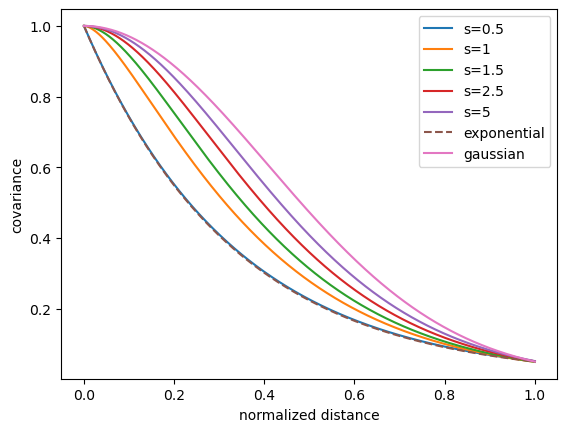

In [5]:
xi = np.linspace(0, 1, 1000)

y_exp = gsim.covariance.exponential_cov_norm(xi, 1, 0)
y_gau = gsim.covariance.gaussian_cov_norm(xi, 1, 0)

ss = [0.5, 1, 1.5, 2.5, 5]

for i, s in enumerate(ss):
    y = gsim.covariance.matern_cov_norm(xi, sill=1.0, nugget=0, s=s)
    plt.plot(xi, y, '-', label=f's={s}')

plt.plot(xi, y_exp, '--', label='exponential')
plt.plot(xi, y_gau, label='gaussian')
plt.xlabel('normalized distance')
plt.ylabel('covariance')
plt.legend()
plt.show()

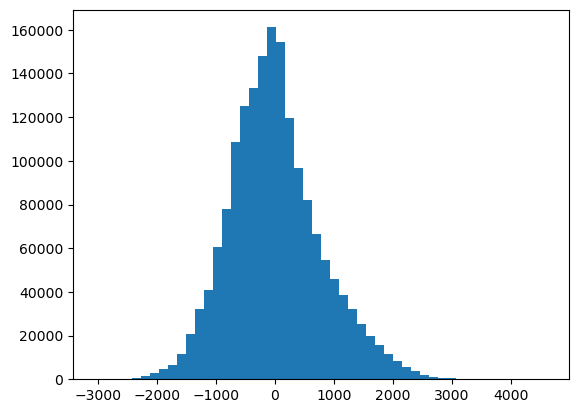

In [6]:
plt.hist(data_cond, bins=50)
plt.show()

In [20]:
sim = np.load(Path('results/nonstationary_sim_1000_1.npy'))

bed = sim + trend

# ilow = 2000
# ihigh = 11600
# jlow = 1400
# jhigh = 12400

ilow = 1000
ihigh = 5800
jlow = 700
jhigh = 6200

xx_trim = xx[ilow:ihigh,jlow:jhigh]
yy_trim = yy[ilow:ihigh,jlow:jhigh]
sim_trim = sim[ilow:ihigh,jlow:jhigh]
trend_trim = trend[ilow:ihigh,jlow:jhigh]
bed_trim = bed[ilow:ihigh,jlow:jhigh]

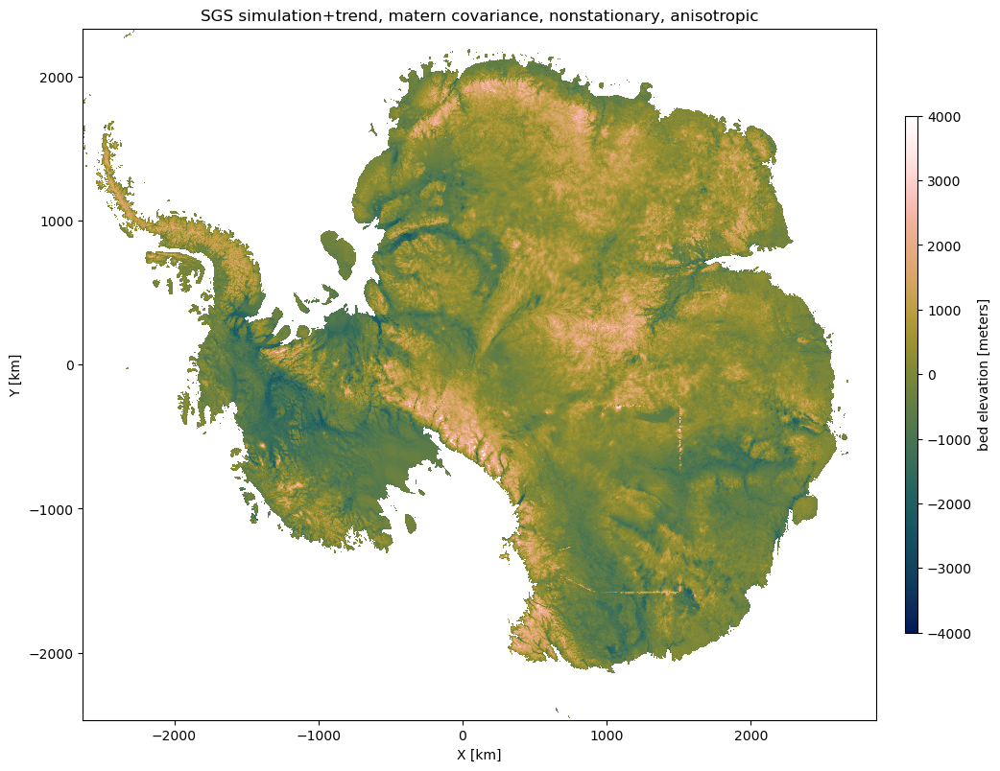

In [21]:
plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, bed_trim, cmap=cm.batlowW, vmin=-4000, vmax=4000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('SGS simulation+trend, matern covariance, nonstationary, anisotropic')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

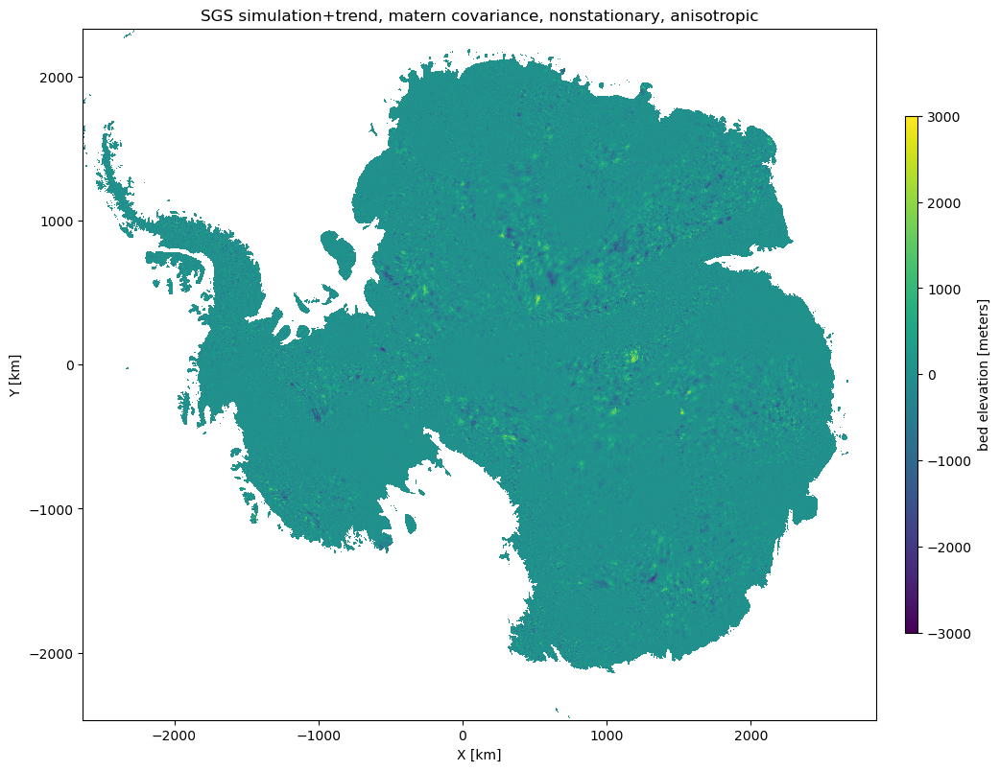

In [24]:
sim1 = np.load(Path('results/nonstationary_sim_1000_0.npy'))
sim2 = np.load(Path('results/nonstationary_sim_1000_1.npy'))

sim1_trim = sim1[ilow:ihigh,jlow:jhigh]
sim2_trim = sim2[ilow:ihigh,jlow:jhigh]

plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, sim1_trim-sim2_trim, vmin=-3000, vmax=3000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('SGS simulation+trend, matern covariance, nonstationary, anisotropic')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

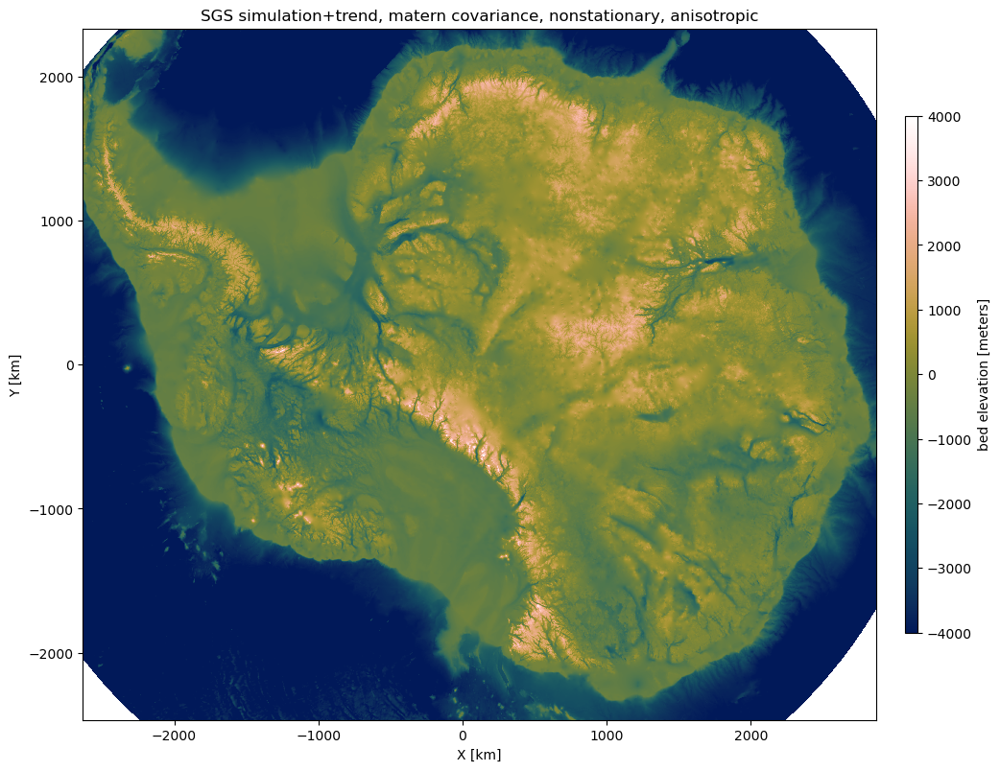

In [11]:
plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, ds.bed_topography[ilow:ihigh,jlow:jhigh], cmap=cm.batlowW, vmin=-4000, vmax=4000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('SGS simulation+trend, matern covariance, nonstationary, anisotropic')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

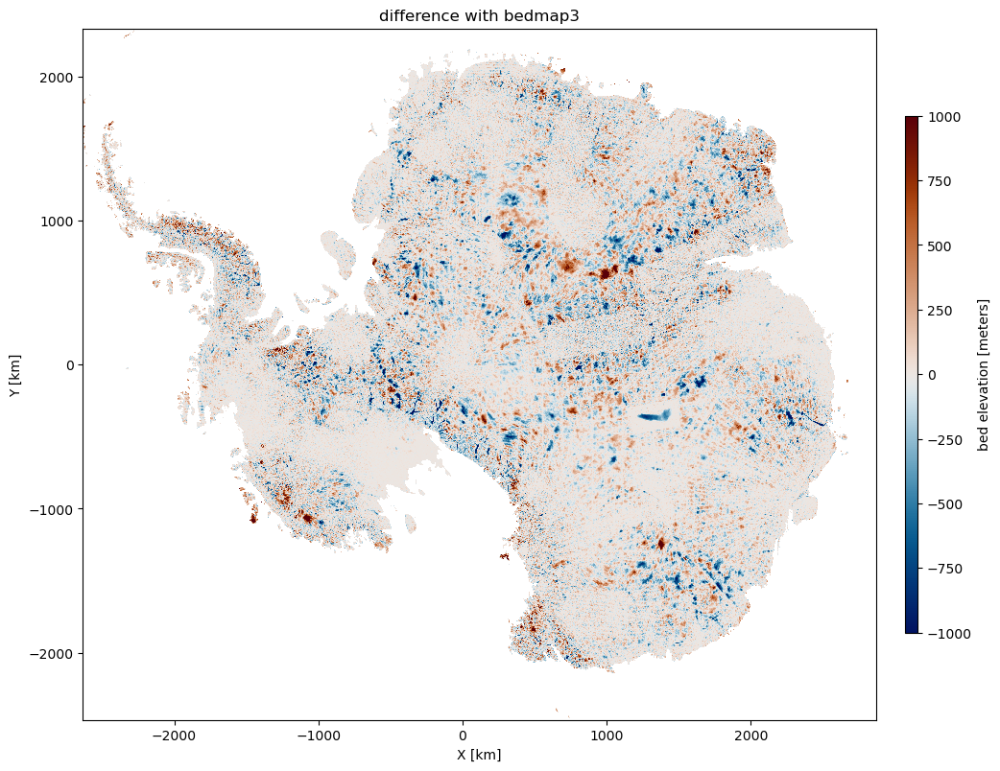

In [8]:
plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, ds.bed_topography[ilow:ihigh,jlow:jhigh]-(sim_trim+trend_trim), cmap=cm.vik, vmin=-1000, vmax=1000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('difference with bedmap3')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

# Block resampling where bed over surface

In [9]:
sim_mask = (ds.mask.values == 1) | (ds.mask.values == 4) | (ds.mask.values == 2)
sim_mask_trim = sim_mask[ilow:ihigh,jlow:jhigh]

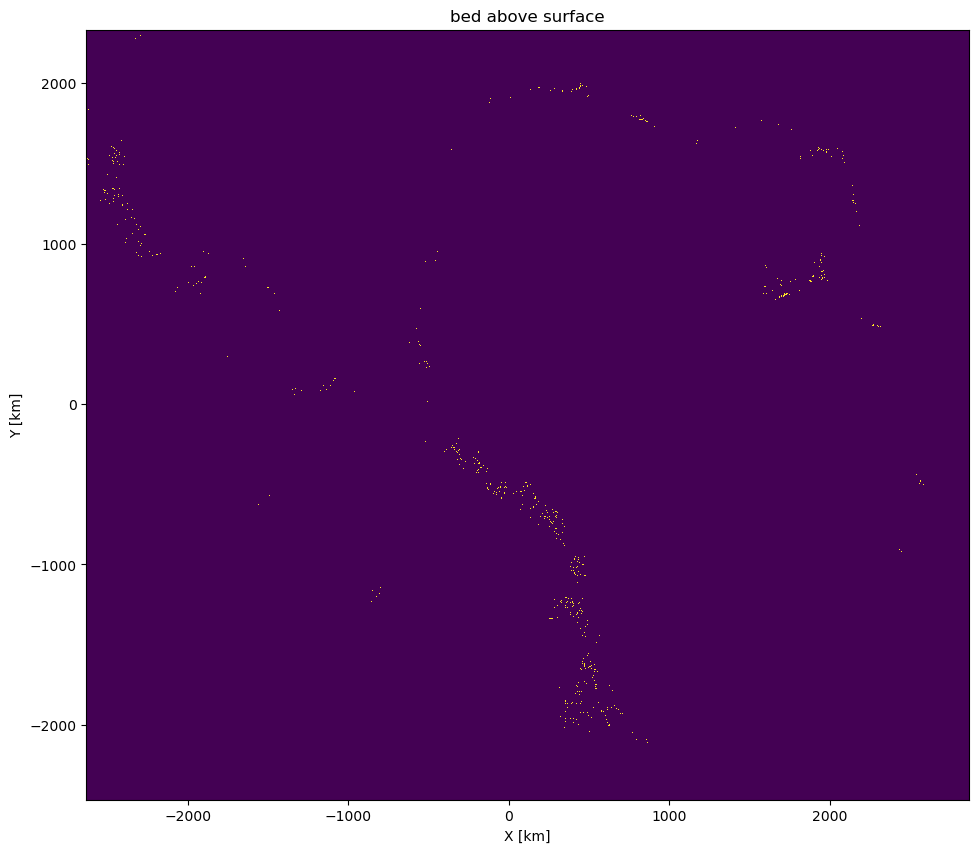

In [10]:
plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, bed_trim > ds.surface_topography[ilow:ihigh,jlow:jhigh])
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('bed above surface')
plt.show()

In [12]:
sim_max_grid = ds.surface_topography.values
bad_msk_prev = (sim > (sim_max_grid-trend)) & (sim_mask==True)
n_bad_prev = np.count_nonzero(bad_msk_prev)
n_bad_prev

26600

In [11]:
def block_resample(xx, yy, ii, jj, field, sim_mask, og_cond_mask, k, vario, rad, bsize, rng, verbose=True):
    
    # choose block
    ni, nj = field.shape

    # # find an index inside the inversion domain
    # goodInd = False
    # while goodInd==False:
    #     ci = rng.integers(0, ni, size=1)[0]
    #     cj = rng.integers(0, nj, size=1)[0]
    #     if sim_mask[ci,cj]==True:
    #         goodInd = True

    iinds = ii[sim_mask]
    jinds = jj[sim_mask]
    rind = rng.integers(0, iinds.size, size=1)[0]
    ci = iinds[rind]
    cj = jinds[rind]
    

    # half width of the block
    hw = bsize//2

    # make sure block extent inside domain
    ilow = max(0, ci-hw)
    ihigh = min(ni-1, ci+hw+1)
    jlow = max(0, cj-hw)
    jhigh = min(nj-1, cj+hw+1)

    # extract everything else as conditioning data
    block_msk = np.full(xx.shape, False)
    # block_msk[ilow:ihigh, jlow:jhigh] = ~og_cond_mask[ilow:ihigh, jlow:jhigh]
    block_msk[ilow:ihigh, jlow:jhigh] = (~og_cond_mask & sim_mask)[ilow:ihigh, jlow:jhigh]
    new_field = np.where(block_msk==True, np.nan, field)
    # plt.imshow(block_msk[ilow:ihigh, jlow:jhigh])
    # plt.show()
    
    # bug: pred grid can have 0 entries. couldn't easily fix so just return original
    if np.count_nonzero(np.isnan(new_field)) == 0:
        if verbose==True:
            print('warning: 0 grid cells in pred grid')
        return field
    else:
        new_sim = gsim.interpolate.sgs(xx, yy, new_field, vario, rad, k, sim_mask=block_msk, quiet=True, seed=rng)
        
    return new_sim, (ilow, ihigh, jlow, jhigh)

def bed_resample(ds, sim, trend, sim_mask, cond_msk, k, vario, rad, rng, max_iter_no_change=100, bsizes=[3, 5, 7], verbose=True):
    xx, yy = np.meshgrid(ds.x, ds.y)
    ii, jj = np.meshgrid(np.arange(xx.shape[0]), np.arange(xx.shape[1]), indexing='ij')
    
    sim_max_grid = ds.surface_topography.values
    
    prev_sim = sim.copy()
    bad_msk_prev = (prev_sim > (sim_max_grid-trend)) & (sim_mask==True)
    n_bad_prev = np.count_nonzero(bad_msk_prev)

    i = 0
    iter_no_change = 0
    
    while n_bad_prev > 0:
        bsize = rng.choice(bsizes)
        next_sim, inds = block_resample(xx, yy, ii, jj, prev_sim, bad_msk_prev, cond_msk, k, vario, rad, bsize, rng, verbose)
        # plt.imshow(next_sim[inds[0]:inds[1],inds[2]:inds[3]]-prev_sim[inds[0]:inds[1],inds[2]:inds[3]], vmin=-100, vmax=100, cmap=cm.vik)
        # plt.show()
        bad_msk_next = (next_sim > (sim_max_grid-trend)) & (sim_mask==True)
        plt.imshow(np.where((bad_msk_next==True) & (bad_msk_prev==False)), vmin=-100, vmax=100, cmap=cm.vik)
        plt.show()
        n_bad_next = np.count_nonzero(bad_msk_next)
        if n_bad_next < n_bad_prev:
            prev_sim = next_sim
            n_bad_prev = n_bad_next
            bad_msk_prev = bad_msk_next
            iter_no_change = 0
        else:
            iter_no_change += 1
        i += 1
        if verbose==True:
            print(f'{i}: {n_bad_prev} bad grid cells. {n_bad_next} tried.')
        
        if iter_no_change >= max_iter_no_change:
            if verbose==True:
                print(f'max iterations with no change reached after {i} iterations')
            break

    if verbose==True:
        print(f'{n_bad_prev} bad grid cells remaining were hard-corrected')
    final_sim = np.where(prev_sim>(sim_max_grid-trend), sim_max_grid - trend, prev_sim)

    return final_sim

In [82]:
thick_cond = np.where(ds.mask.values == 4, 0, ds.thick_cond.values)
bed_cond = ds.surface_topography.values - thick_cond
ice_rock_msk = (ds.mask.values == 1) | (ds.mask.values == 4) | (ds.mask.values == 2)
bed_cond = np.where(ice_rock_msk, bed_cond, np.nan)
cond_msk = ~np.isnan(bed_cond)

In [83]:
rng = np.random.default_rng(0)
k = 24
rad = 50e3

dsv = xr.load_dataset(Path('processed_data/continental_variogram_1000.nc'))

vario = {
    'azimuth' : dsv.azimuth.values,
    'nugget' : 0,
    'major_range' : dsv.major_range.values,
    'minor_range' : dsv.minor_range.values,
    'sill' : dsv.sill.values,
    's' : dsv.smooth.values,
    'vtype' : 'matern',
}

max_iter_no_change = 10
bsizes = [7,15,21]

resample_sim = bed_resample(ds, sim, trend, sim_mask, cond_msk, k, vario, rad, rng, max_iter_no_change, bsizes)

21 290
1: 215475 bad grid cells. 216471 tried.
7 25
2: 215475 bad grid cells. 216674 tried.
15 86
3: 215475 bad grid cells. 216406 tried.
21 313
4: 215475 bad grid cells. 216728 tried.
15 70
5: 215475 bad grid cells. 216736 tried.
21 66
6: 215475 bad grid cells. 216643 tried.
21 417
7: 215475 bad grid cells. 216708 tried.
7 18
8: 215475 bad grid cells. 216679 tried.
15 119
9: 215475 bad grid cells. 216581 tried.
7 42
10: 215475 bad grid cells. 216591 tried.
max iterations with no change reached after 10 iterations
215475 bad grid cells remaining were hard-corrected


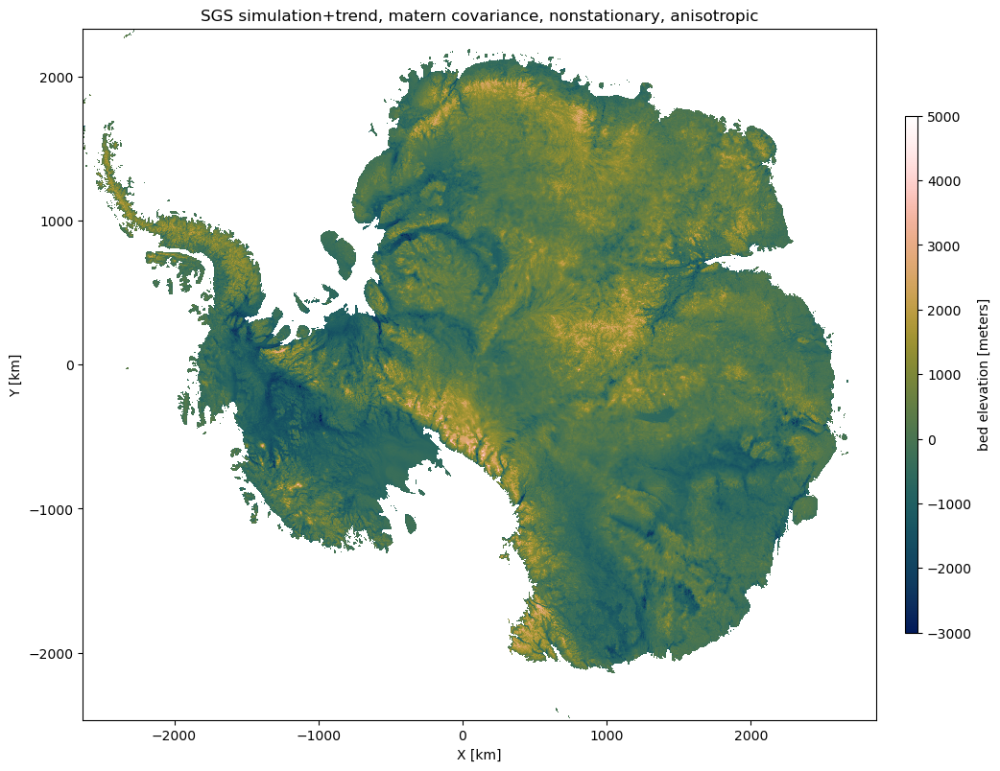

In [44]:
plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, resample_sim[ilow:ihigh,jlow:jhigh]+trend_trim, cmap=cm.batlowW, vmin=-3000, vmax=5000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('SGS simulation+trend, matern covariance, nonstationary, anisotropic')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

In [46]:
resample_trim = resample_sim[ilow:ihigh,jlow:jhigh]

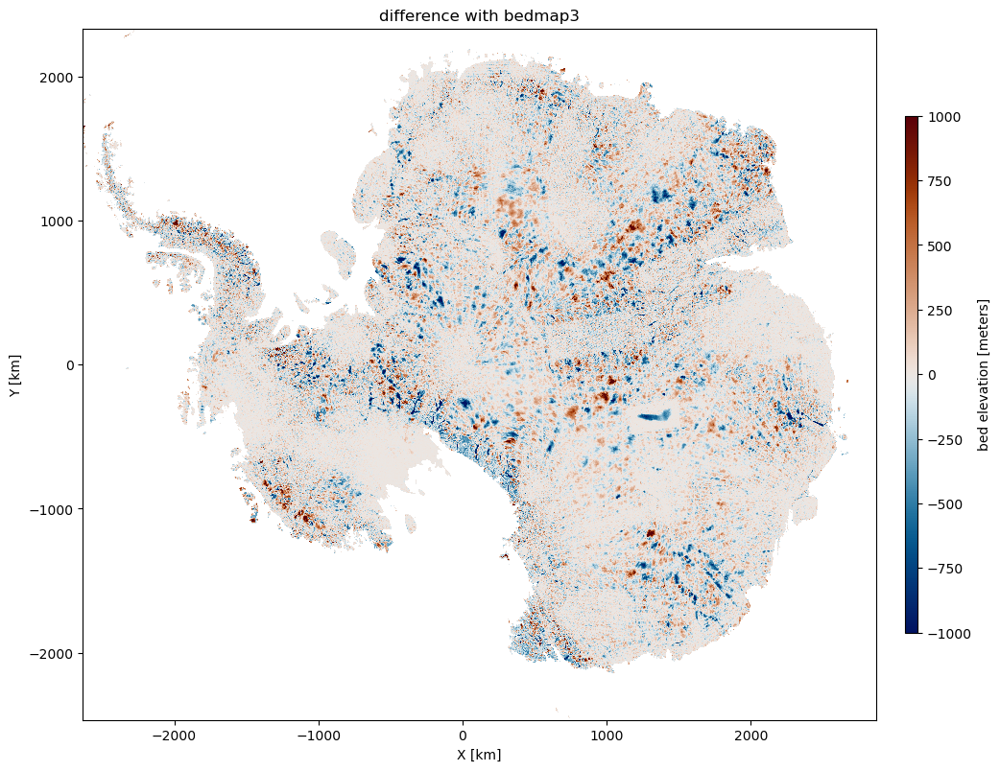

In [47]:
plt.figure(figsize=(13,10))
im = plt.pcolormesh(xx_trim/1000, yy_trim/1000, ds.bed_topography[ilow:ihigh,jlow:jhigh]-(resample_trim+trend_trim), cmap=cm.vik, vmin=-1000, vmax=1000)
plt.axis('scaled')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('difference with bedmap3')
plt.colorbar(im, pad=0.03, aspect=40, shrink=0.7, label='bed elevation [meters]')
plt.show()

In [34]:
sim_max_grid = ds.surface_topography.values

prev_sim = sim.copy()
bad_msk_prev = (prev_sim > (sim_max_grid-trend)) & sim_mask
n_bad_prev = np.count_nonzero(bad_msk_prev)
n_bad_prev

215475

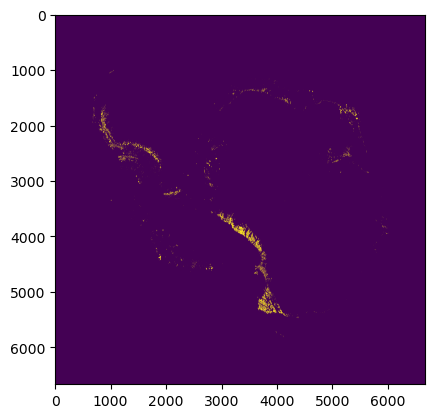

In [35]:
plt.imshow(bad_msk_prev)
plt.show()

In [43]:
np.nanmax(ds.bed_topography.values)

np.float32(4578.0)

In [101]:
from scipy.stats import truncnorm

vals = truncnorm.rvs(a=-1, b=2, loc=0, scale=1, size=10_000, random_state=rng)

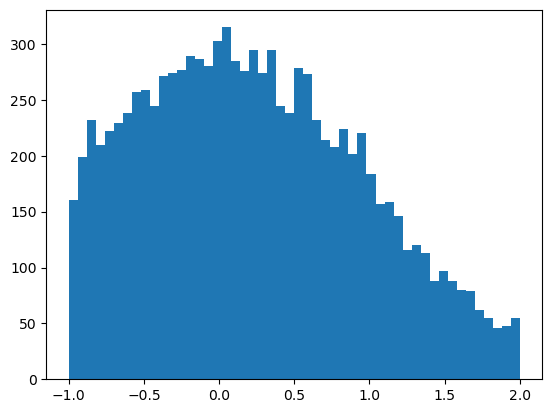

In [102]:
plt.hist(vals, bins=50)
plt.show()

In [111]:
a = -1
b = 2
loc = 3
scale = 2
a_transformed, b_transformed = (a - loc) / scale, (b - loc) / scale
vals = truncnorm.rvs(a_transformed, b_transformed, loc=loc, scale=scale, size=10_000, random_state=rng)

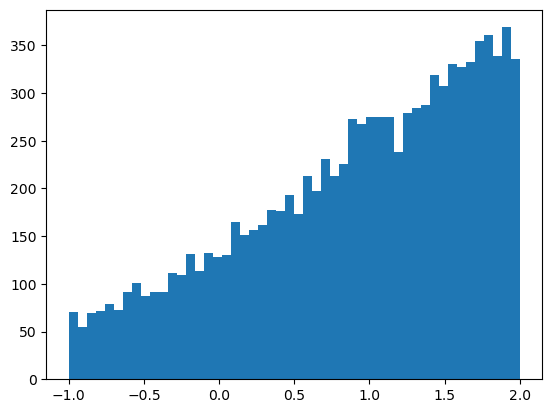

In [112]:
plt.hist(vals, bins=50)
plt.show()

In [2]:
ds = xr.load_dataset(Path('processed_data/test_data.nc'))

bed_cond = ds.surface_topography.values - ds.thick_cond.values
xx, yy = np.meshgrid(ds.x, ds.y)

cond_msk = ~np.isnan(bed_cond)
x_cond = xx[cond_msk]
y_cond = yy[cond_msk]
data_cond = bed_cond[cond_msk]

smoothing = 1e11
interp = RBFInterpolator(np.array([x_cond, y_cond]).T, data_cond, smoothing=smoothing)
trend = interp(np.array([xx.flatten(), yy.flatten()]).T).reshape(xx.shape)
res_cond = bed_cond - trend

res_norm, nst_trans = gsim.utilities.gaussian_transformation(res_cond, cond_msk)

In [12]:
vgrams, experimental, bins = gsim.utilities.variograms(xx, yy, res_cond, maxlag=30e3, n_lags=20, downsample=10)

parameters = vgrams['matern']

vario = {
    'azimuth' : 0,
    'nugget' : parameters[-1],
    'major_range' : parameters[0],
    'minor_range' : parameters[0],
    'sill' : parameters[1],
    's' : parameters[2],
    'vtype' : 'matern',
}

rng = np.random.default_rng(0)

k = 20
rad = 50e3

bounds = (-500, np.full(xx.shape, 750))

sim_bound = gsim.interpolate.sgs(xx, yy, res_cond, vario, rad, k, bounds=bounds, seed=0)
sim = gsim.interpolate.sgs(xx, yy, res_cond, vario, rad, k, bounds=None, seed=0)



  0%|          | 0/60000 [00:00<?, ?it/s]

  0%|          | 0/60000 [00:00<?, ?it/s]

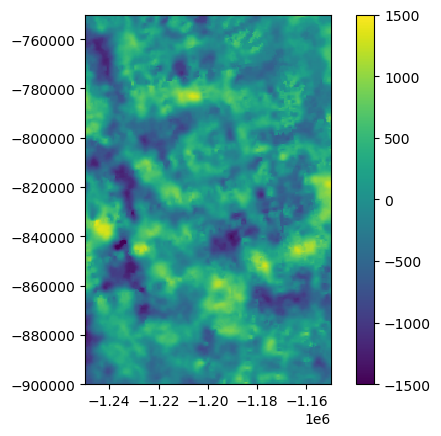

In [13]:
plt.pcolormesh(ds.x, ds.y, sim, vmin=-1500, vmax=1500)
plt.axis('scaled')
plt.colorbar()
plt.show()

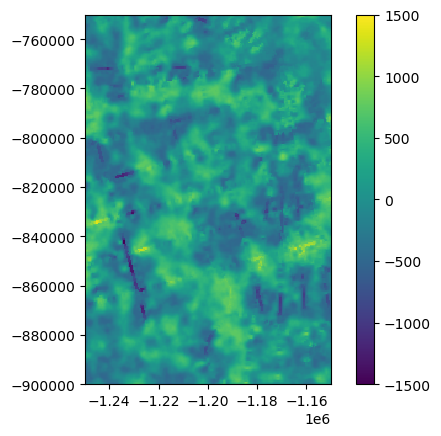

In [14]:
plt.pcolormesh(ds.x, ds.y, sim_bound, vmin=-1500, vmax=1500)
plt.axis('scaled')
plt.colorbar()
plt.show()

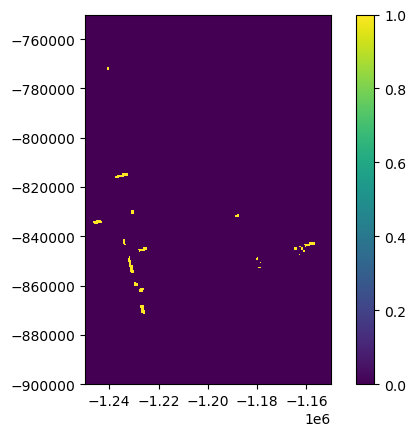

In [7]:
plt.pcolormesh(ds.x, ds.y, np.abs(sim_bound) > 1000)
plt.axis('scaled')
plt.colorbar()
plt.show()

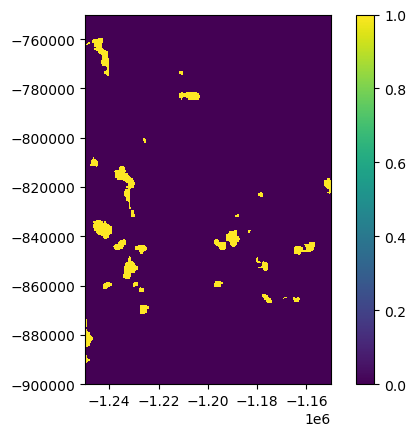

In [8]:
plt.pcolormesh(ds.x, ds.y, np.abs(sim) > 1000)
plt.axis('scaled')
plt.colorbar()
plt.show()

In [156]:
from scripts.utilities import *

rename_dict = {
    'surface_altitude (m)' : 'surface',
    'land_ice_thickness (m)' : 'thickness',
    'bedrock_altitude (m)' : 'bed',
    'longitude (degree_east)' : 'lon',
    'latitude (degree_north)' : 'lat'
}

def collect_files(path, verbose=False):
    total = 0
    for item in os.scandir(path):
        if item.name.endswith('.csv'):
            total += 1
    
    dfs = []
    
    for i, item in tqdm(enumerate(os.scandir(path)), total=total):
        if item.name.endswith('.csv'):
            if verbose==True:
                print(item.path)
            dfs.append(pd.read_csv(item.path, header=18))

    if len(dfs)==1:
        df = dfs[0]
    else:
        df = pd.concat(dfs)
    df = df.rename(columns=rename_dict)
    df = df[['surface', 'thickness', 'bed', 'lat', 'lon']]
    df = df.replace(-9999, np.nan)
    
    return df

tic = time.time()

bm1path = Path('D:/bedmap/BEDMAP1')
bm2path = Path('D:/bedmap/BEDMAP2')
bm3path = Path('D:/bedmap/BEDMAP3')
bmgrid_path = Path('D:/bedmap/bedmap3.nc')
bmach_path = Path('D:/bedmachine/BedMachineAntarctica-v3.nc')
stream_path = Path('D:/bedmap/bm3_streamlines_pt/bm3_streamlines_pt.shp')

ds = xr.open_dataset(Path('processed_data/bedmap3_mod_1000.nc'))

print('collecting files')
bm1 = collect_files(bm1path)
bm2 = collect_files(bm2path)
bm3 = collect_files(bm3path)

df = pd.concat([bm1, bm2, bm3])

del(bm1)
del(bm2)
del(bm3)

x_coords, y_coords = geo2ant(df['lat'], df['lon'])
df['x'] = x_coords
df['y'] = y_coords

msk = (df['thickness'].isna()==True) & (df['surface'].isna()==False) & (df['bed'].isna()==False)
df.loc[msk, 'thickness'] = df.loc[msk, 'surface'] - df.loc[msk, 'bed']

df = df.loc[df['thickness'].isna()==False]

ds = xr.open_dataset(bmgrid_path)
xx, yy = np.meshgrid(ds.x, ds.y)

collecting files


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/66 [00:00<?, ?it/s]

  0%|          | 0/84 [00:00<?, ?it/s]

In [157]:
# find bad surface
kn = vd.KNeighbors(k=1)
kn.fit((xx.flatten(), yy.flatten()), ds.surface_topography.values.flatten())
preds = kn.predict((df.x, df.y))

In [158]:
good_surface = (np.abs(df['surface'].values-preds)<200) | (df['surface'].isna()==True)

In [159]:
# find bad ice thickness
kn = vd.KNeighbors(k=1)
kn.fit((xx.flatten(), yy.flatten()), ds.ice_thickness.values.flatten())
preds_thick = kn.predict((df.x, df.y))

In [160]:
good_thick = (df['thickness'].values-preds_thick)<200

In [161]:
ilow = 1000
ihigh = 5800
jlow = 700
jhigh = 6200

xx, yy = np.meshgrid(ds.x, ds.y)

xx_trim = xx[ilow:ihigh,jlow:jhigh]
yy_trim = yy[ilow:ihigh,jlow:jhigh]
mask_trim = ds.mask.values[ilow:ihigh,jlow:jhigh]

ice_rock_msk = (ds.mask.values == 1) | (ds.mask.values == 4) | (ds.mask.values == 2)

In [165]:
coldex = pd.read_csv(Path('D:/bedmap/2023_Antarctica_BaslerMKB.csv'))
coldex

,LAT,LON,UTCTIMESOD,THICK,ELEVATION,FRAME,SURFACE,BOTTOM,QUALITY
0,-77.544319,166.174005,11899.2039,0.00,563.5301,2023120901001,611.58,611.58,1
1,-77.544102,166.173463,11899.5128,0.00,563.4308,2023120901001,611.58,611.58,1
2,-77.543886,166.172921,11899.8217,0.00,563.3314,2023120901001,611.58,611.58,1
3,-77.543669,166.172379,11900.1319,0.00,563.2880,2023120901001,611.58,611.58,1
4,-77.543452,166.171836,11900.4438,0.00,563.3209,2023120901001,611.58,611.58,1
...,...,...,...,...,...,...,...,...,...
935387,-77.573855,165.896336,95468.9393,4.22,633.5237,2024011201031,691.02,695.24,1
935388,-77.574083,165.896762,95469.3372,4.07,633.0547,2024011201031,691.02,695.09,1
935389,-77.574312,165.897187,95469.7352,3.14,632.5909,2024011201031,690.32,693.46,1
935390,-77.574541,165.897610,95470.1333,3.38,632.1184,2024011201031,689.52,692.90,1


In [166]:
x_coords, y_coords = geo2ant(coldex['LAT'], coldex['LON'])
coldex['x'] = x_coords
coldex['y'] = y_coords

In [168]:
coldex = coldex.rename(columns={'LAT' : 'lat', 'LON' : 'lon', 'THICK' : 'thickness', 'SURFACE' : 'surface', 'BOTTOM' : 'bed'})
coldex = coldex[['surface', 'thickness', 'bed', 'lat', 'lon', 'x', 'y']]
coldex

,surface,thickness,bed,lat,lon,x,y
0,611.58,0.00,611.58,-77.544319,166.174005,324641.411515,-1.319119e+06
1,611.58,0.00,611.58,-77.544102,166.173463,324659.589009,-1.319139e+06
2,611.58,0.00,611.58,-77.543886,166.172921,324677.740650,-1.319159e+06
3,611.58,0.00,611.58,-77.543669,166.172379,324695.918965,-1.319179e+06
4,611.58,0.00,611.58,-77.543452,166.171836,324714.120716,-1.319199e+06
...,...,...,...,...,...,...,...
935387,691.02,4.22,695.24,-77.573855,165.896336,330239.424291,-1.314383e+06
935388,691.02,4.07,695.09,-77.574083,165.896762,330223.546669,-1.314361e+06
935389,690.32,3.14,693.46,-77.574312,165.897187,330207.665556,-1.314339e+06
935390,689.52,3.38,692.90,-77.574541,165.897610,330191.830668,-1.314317e+06


In [169]:
df = pd.concat([df, coldex])

In [170]:
df

,surface,thickness,bed,lat,lon,x,y
0,NaN,2650.00,NaN,-75.623000,4.449000,121788.567945,1.565282e+06
1,NaN,2628.00,NaN,-75.621000,4.438000,121505.125021,1.565526e+06
2,NaN,2620.00,NaN,-75.619000,4.425000,121166.937514,1.565773e+06
3,NaN,2635.00,NaN,-75.619000,4.420000,121030.297575,1.565784e+06
4,NaN,2646.00,NaN,-75.617000,4.407000,120691.982493,1.566031e+06
...,...,...,...,...,...,...,...
935387,691.02,4.22,695.24,-77.573855,165.896336,330239.424291,-1.314383e+06
935388,691.02,4.07,695.09,-77.574083,165.896762,330223.546669,-1.314361e+06
935389,690.32,3.14,693.46,-77.574312,165.897187,330207.665556,-1.314339e+06
935390,689.52,3.38,692.90,-77.574541,165.897610,330191.830668,-1.314317e+06


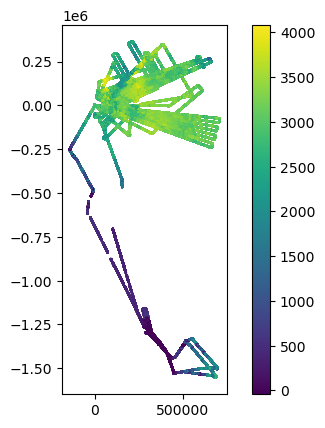

In [129]:
plt.scatter(coldex.x, coldex.y, c=coldex.THICK, s=0.5)
plt.axis('scaled')
plt.colorbar()
plt.show()

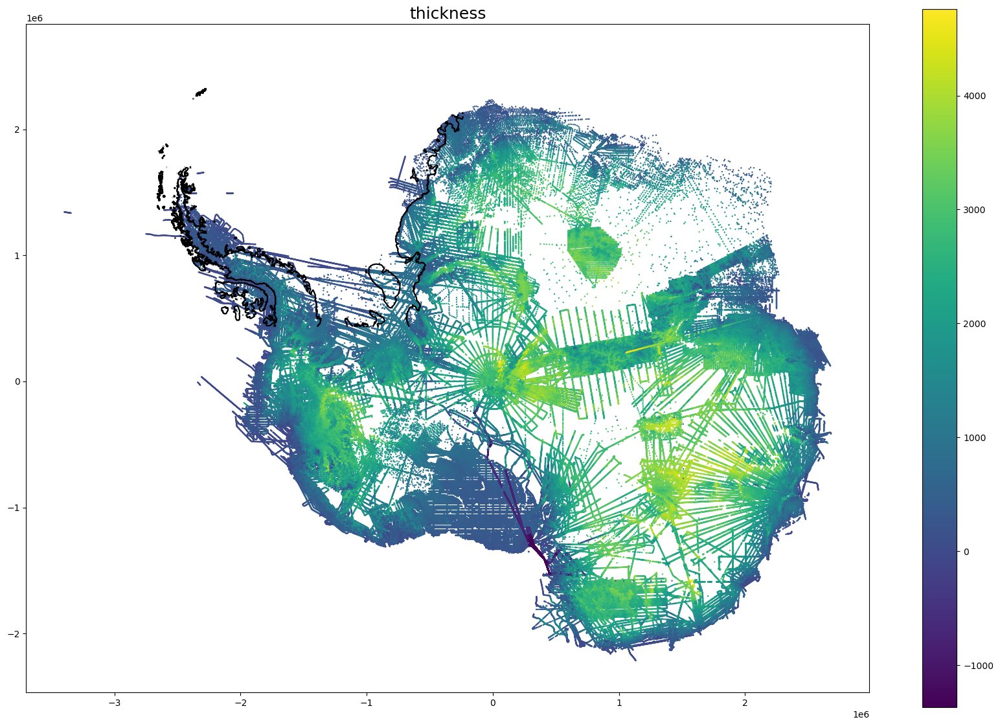

In [155]:
fig, ax = plt.subplots(1, 1, figsize=(21,14))

im = ax.scatter(df.x[::100], df.y[::100], c=df.thickness[::100], s=0.5)
plt.scatter(coldex.x, coldex.y, c=coldex.THICK, s=0.5, cmap='viridis')
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('thickness', fontsize=18)
plt.colorbar(im, ax=ax)
plt.show()

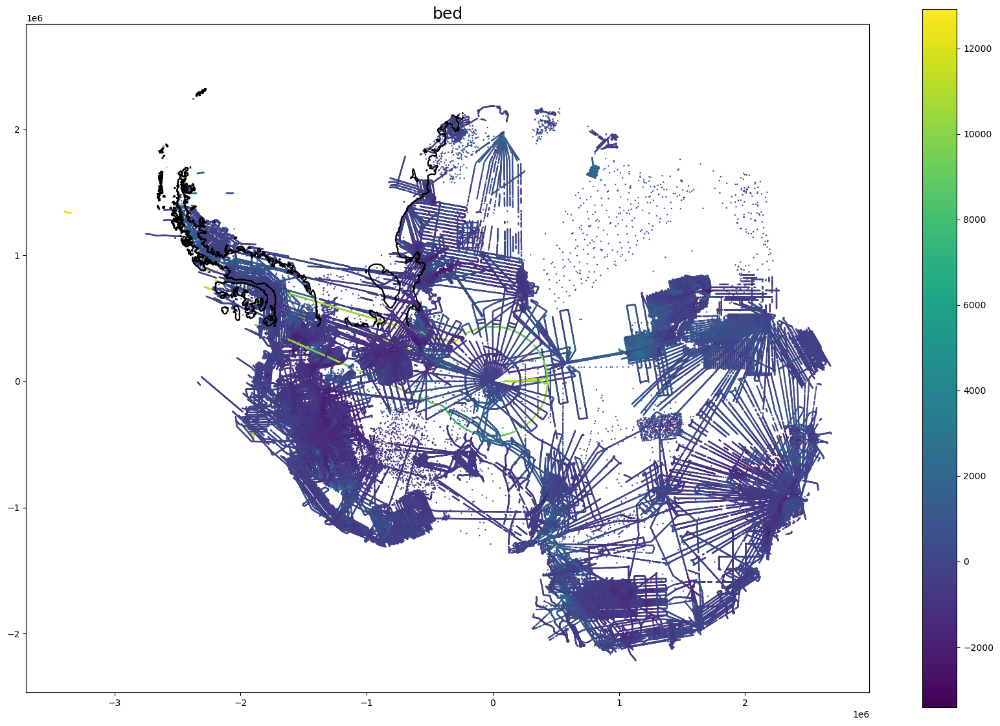

In [101]:
fig, ax = plt.subplots(1, 1, figsize=(21,14))

im = ax.scatter(df.x[::100], df.y[::100], c=df.bed[::100], s=0.5)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bed', fontsize=18)
plt.colorbar(im, ax=ax)
plt.show()

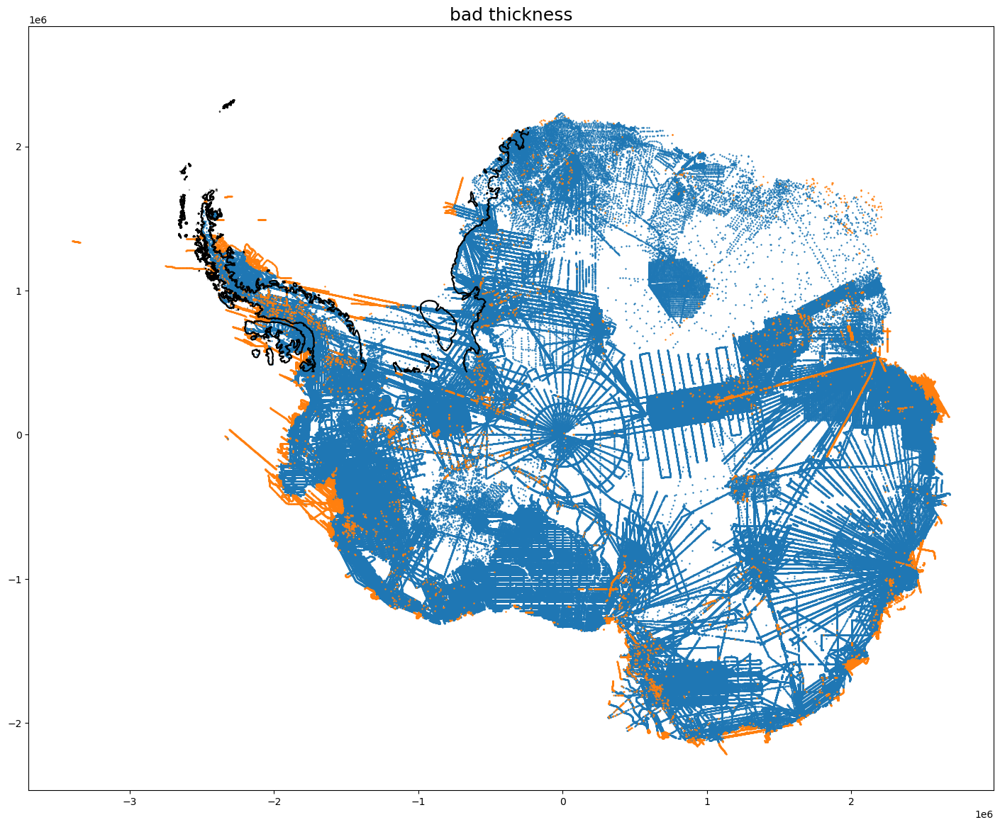

In [125]:
fig, ax = plt.subplots(1, 1, figsize=(21,14))

# im = ax.scatter(df.x[::100], df.y[::100], c=~good_surface[::100], s=0.5, cmap='RdBu_r')
ax.scatter(df.x[good_thick][::100], df.y[good_thick][::100], c='tab:blue', s=0.5)
ax.scatter(df.x[~good_thick][::100], df.y[~good_thick][::100], c='tab:orange', s=0.5)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bad thickness', fontsize=18)

plt.show()

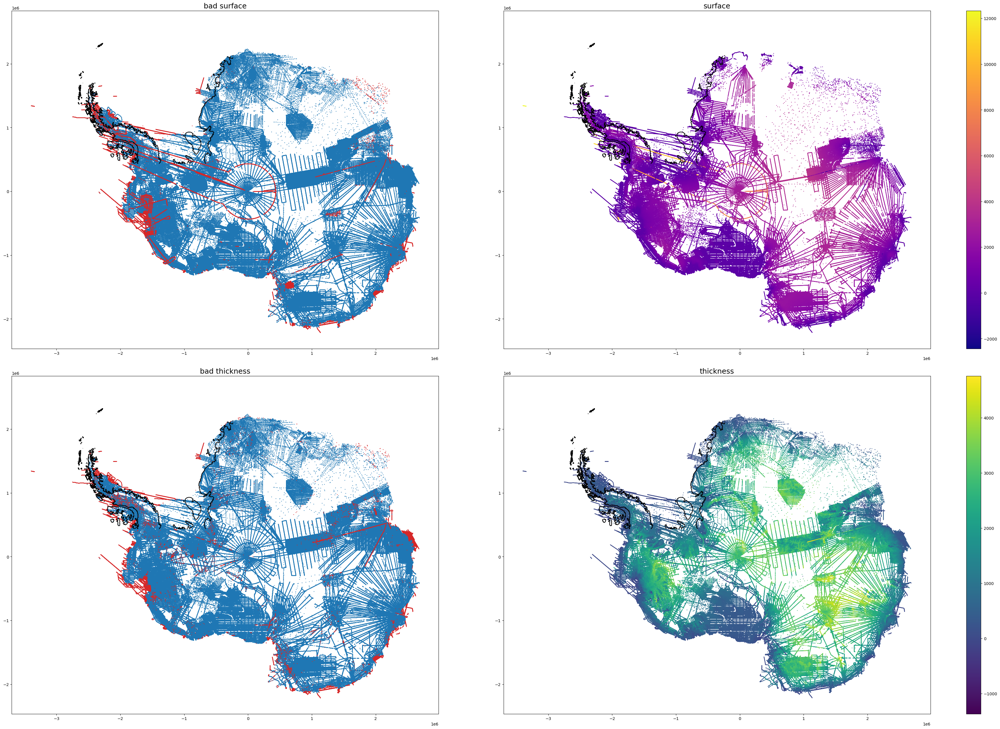

In [147]:
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(35,25), constrained_layout=True)
gs = GridSpec(2, 3, width_ratios=[1, 1, 0.03], figure=fig)

#fig, axs = plt.subplots(2, 2, figsize=(35, 28), sharey=True, sharex=True)

ax = fig.add_subplot(gs[0,0])
ax.scatter(df.x[good_surface][::100], df.y[good_surface][::100], c='tab:blue', s=0.5)
ax.scatter(df.x[~good_surface][::100], df.y[~good_surface][::100], c='tab:red', s=0.5)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bad surface', fontsize=18)

ax = fig.add_subplot(gs[0,1])
im = ax.scatter(df.x[::100], df.y[::100], c=df.surface[::100], s=0.5, cmap='plasma')
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('surface', fontsize=18)
cax = fig.add_subplot(gs[0,2])
plt.colorbar(im, cax=cax)

ax = fig.add_subplot(gs[1,0])
ax.scatter(df.x[good_thick][::100], df.y[good_thick][::100], c='tab:blue', s=0.5)
ax.scatter(df.x[~good_thick][::100], df.y[~good_thick][::100], c='tab:red', s=0.5)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bad thickness', fontsize=18)

ax = fig.add_subplot(gs[1,1])
im = ax.scatter(df.x[::100], df.y[::100], c=df.thickness[::100], s=0.5)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('thickness', fontsize=18)
cax = fig.add_subplot(gs[1,2])
plt.colorbar(im, cax=cax)

plt.show()

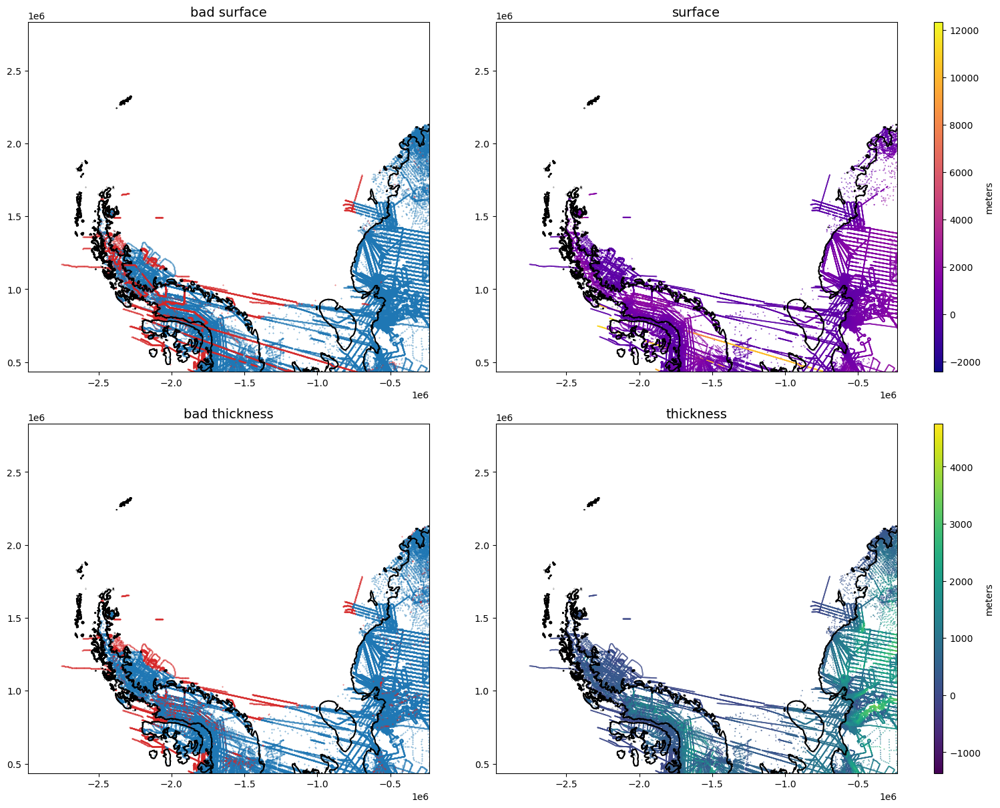

In [153]:
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(15,12), constrained_layout=True)
gs = GridSpec(2, 3, width_ratios=[1, 1, 0.02], figure=fig)

ax = fig.add_subplot(gs[0,0])
ax.scatter(df.x[good_surface][::100], df.y[good_surface][::100], c='tab:blue', s=0.1)
ax.scatter(df.x[~good_surface][::100], df.y[~good_surface][::100], c='tab:red', s=0.1)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bad surface', fontsize=14)
ax.set_xlim(xx_trim.min(), xx_trim.max())
ax.set_ylim(yy_trim.min(), yy_trim.max())

ax = fig.add_subplot(gs[0,1])
im = ax.scatter(df.x[::100], df.y[::100], c=df.surface[::100], s=0.1, cmap='plasma')
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('surface', fontsize=14)
cax = fig.add_subplot(gs[0,2])
plt.colorbar(im, cax=cax, label='meters')
ax.set_xlim(xx_trim.min(), xx_trim.max())
ax.set_ylim(yy_trim.min(), yy_trim.max())

ax = fig.add_subplot(gs[1,0])
ax.scatter(df.x[good_thick][::100], df.y[good_thick][::100], c='tab:blue', s=0.1)
ax.scatter(df.x[~good_thick][::100], df.y[~good_thick][::100], c='tab:red', s=0.1)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bad thickness', fontsize=14)
ax.set_xlim(xx_trim.min(), xx_trim.max())
ax.set_ylim(yy_trim.min(), yy_trim.max())

ax = fig.add_subplot(gs[1,1])
im = ax.scatter(df.x[::100], df.y[::100], c=df.thickness[::100], s=0.1)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('thickness', fontsize=14)
cax = fig.add_subplot(gs[1,2])
plt.colorbar(im, cax=cax, label='meters')
ax.set_xlim(xx_trim.min(), xx_trim.max())
ax.set_ylim(yy_trim.min(), yy_trim.max())

plt.show()

In [107]:
rng = np.random.default_rng(0)

n_points = 2000

# randomly sample with latin hypercube sampling
bounds = [ds.x.values.min(), ds.y.values.min(), ds.x.values.max(), ds.y.values.max()]
l_bounds = bounds[:2]
u_bounds = bounds[2:]

sampler = qmc.LatinHypercube(d=2, optimization="lloyd", scramble=True, rng=rng)
sample = sampler.random(n=n_points)
points = qmc.scale(sample, l_bounds, u_bounds)

ground_ice_rock_msk = (ds.mask==1) | (ds.mask==4) | (ds.mask==2)

good_points = np.full(points.shape[0], True)

for k, p in enumerate(points):
    i = np.argmin(np.abs(ds.y.values - p[1]))
    j = np.argmin(np.abs(ds.x.values - p[0]))
    if ground_ice_rock_msk[i, j] == False:
        good_points[k] = False

points = points[good_points,:]

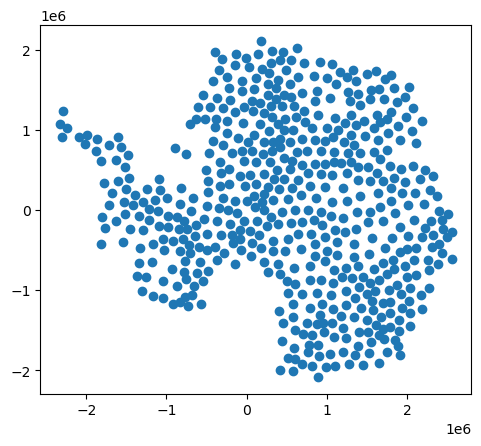

In [108]:
plt.scatter(points[:,0], points[:,1])
plt.axis('scaled')
plt.show()

In [ ]:
for p in points:
    msk = vd.distance_mask((p[0], [[1]), maxdist=50e3, coordinates=(df.x.values, df.y.values))

In [109]:
msk = vd.distance_mask((points[0,0], points[0,1]), maxdist=50e3, coordinates=(df.x.values, df.y.values))

In [112]:
msk.shape

(82555825,)

In [113]:
df.shape

(82555825, 11)

In [116]:
from scipy.stats import zscore

score = zscore(df.thickness.values[msk==True])

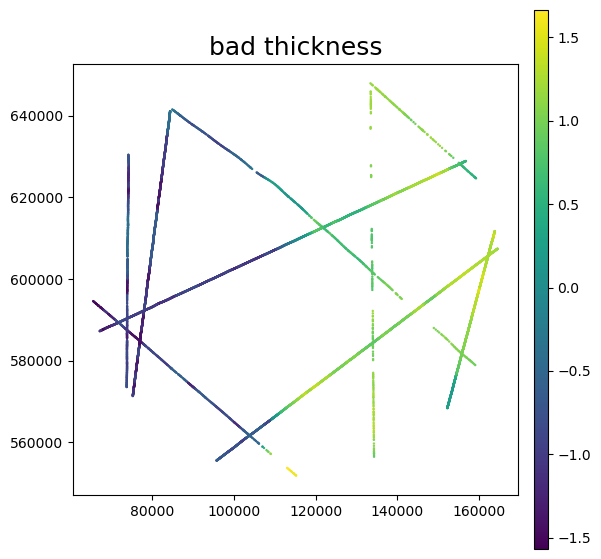

In [118]:
fig, ax = plt.subplots(1, 1, figsize=(7,7))

# im = ax.scatter(df.x[::100], df.y[::100], c=~good_surface[::100], s=0.5, cmap='RdBu_r')
im = ax.scatter(df.x[msk], df.y[msk], c=score, s=0.5)
#ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('bad thickness', fontsize=18)
plt.colorbar(im, ax=ax, pad=0.03, aspect=40)
plt.show()

In [120]:
all_score = np.full(len(df), np.nan)

for p in tqdm(points):
    msk = vd.distance_mask((p[0], p[1]), maxdist=100e3, coordinates=(df.x.values, df.y.values))
    score = zscore(df.thickness.values[msk==True])
    np.place(all_score, msk, score)

  0%|          | 0/528 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [66]:
df

,trajectory_id,surface,thickness,bed,lat,lon,x,y
0,1,NaN,2650.000000,NaN,-75.623000,4.449000,121788.567945,1.565282e+06
1,2,NaN,2628.000000,NaN,-75.621000,4.438000,121505.125021,1.565526e+06
2,3,NaN,2620.000000,NaN,-75.619000,4.425000,121166.937514,1.565773e+06
3,4,NaN,2635.000000,NaN,-75.619000,4.420000,121030.297575,1.565784e+06
4,5,NaN,2646.000000,NaN,-75.617000,4.407000,120691.982493,1.566031e+06
...,...,...,...,...,...,...,...,...
58396,15.0,2809.073374,2915.797188,-106.723814,-89.909184,-133.157914,-7198.004218,-6.749433e+03
58397,15.0,2809.122107,2916.219688,-107.097582,-89.909205,-133.147029,-7197.577479,-6.746464e+03
58398,15.0,2809.127845,2916.642188,-107.514344,-89.909227,-133.136578,-7197.055965,-6.743509e+03
58399,15.0,2809.132123,2917.064688,-107.932566,-89.909249,-133.126111,-7196.537221,-6.740555e+03


In [67]:
df.trajectory_id.unique()

array([1, 2, 3, ..., 'SR2HI2_2016028_OIA_JKB2n_Y88a',
       'SR2HI2_2016030_VCD_JKB2n_DVD02a',
       'SR2HI2_2016030_VCD_JKB2n_ECX21a'], dtype=object)

In [71]:
df['is_numeric'] = pd.to_numeric(df['trajectory_id'], errors='coerce').notna()

In [87]:
df['trajectory_mod'] = df.trajectory_id.where(df.is_numeric==True, np.nan).astype(float)

In [96]:
df['new_id'] = pd.factorize(df.trajectory_id)[0]

In [88]:
viridis = plt.get_cmap('viridis')
viridis.set_bad('r')

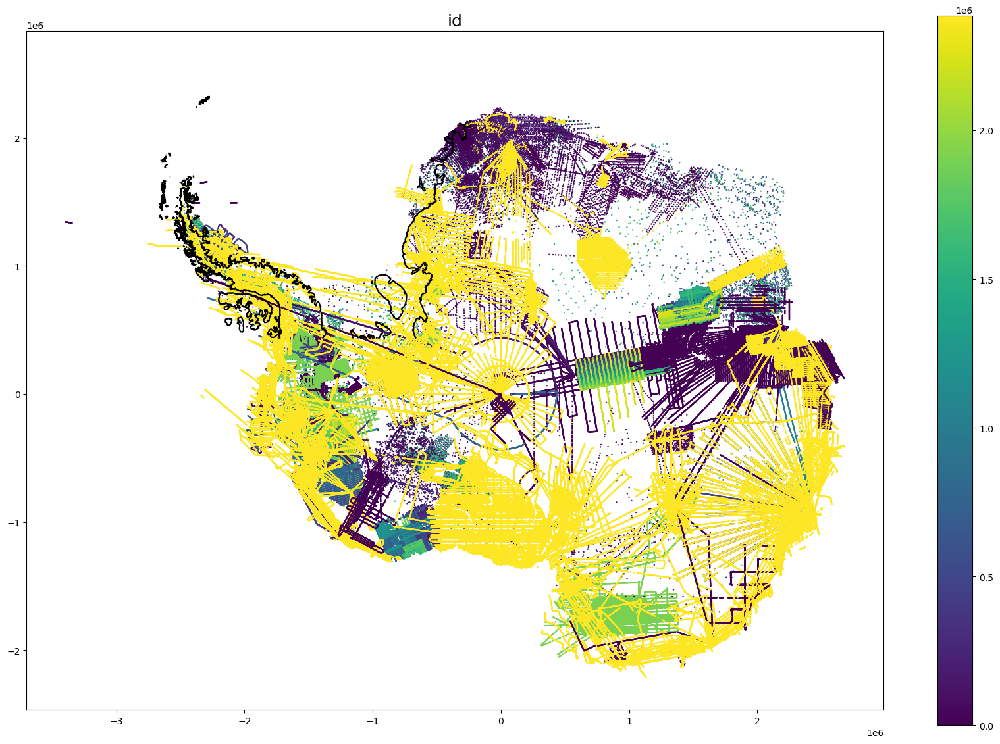

In [97]:
fig, ax = plt.subplots(1, 1, figsize=(21,14))

im = ax.scatter(df.x[::100], df.y[::100], c=df.new_id[::100], s=0.5, cmap=viridis)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('id', fontsize=18)
plt.colorbar(im, ax=ax)
plt.show()

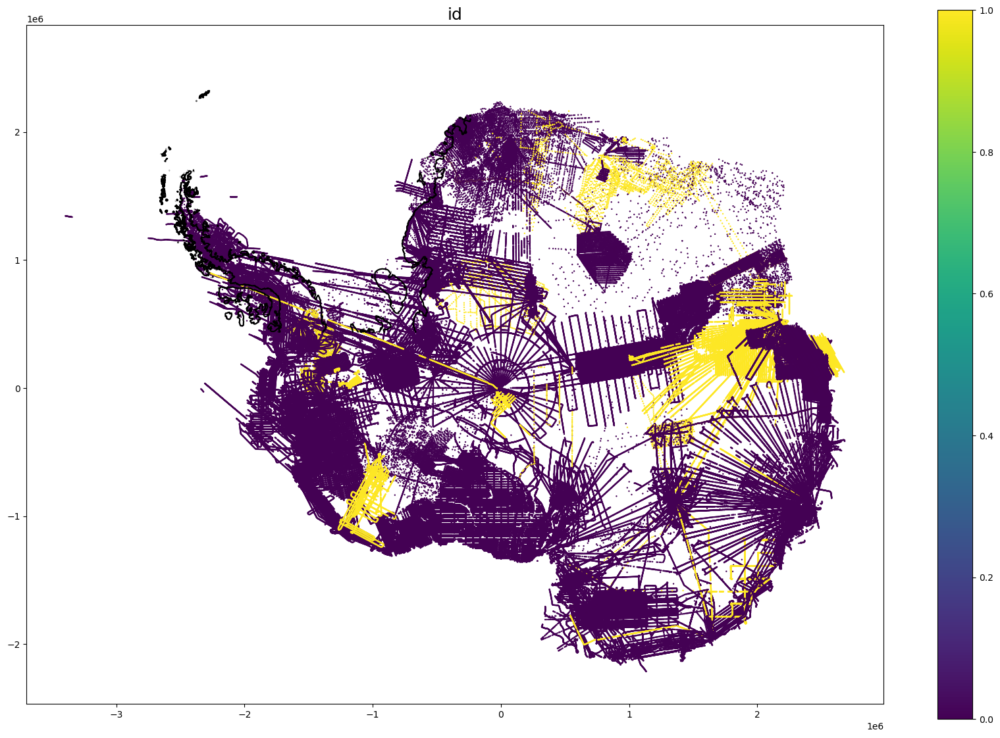

In [98]:
fig, ax = plt.subplots(1, 1, figsize=(21,14))

im = ax.scatter(df.x[::100], df.y[::100], c=df.trajectory_id.isna()[::100], s=0.5, cmap=viridis)
ax.contour(xx_trim, yy_trim, ice_rock_msk[ilow:ihigh,jlow:jhigh], levels=[0.5], colors='k')
ax.axis('scaled')
ax.set_title('id', fontsize=18)
plt.colorbar(im, ax=ax)
plt.show()

In [83]:
df

,trajectory_id,surface,thickness,bed,lat,lon,x,y,is_numeric,trajectory_mod
0,1,NaN,2650.000000,NaN,-75.623000,4.449000,121788.567945,1.565282e+06,True,1
1,2,NaN,2628.000000,NaN,-75.621000,4.438000,121505.125021,1.565526e+06,True,2
2,3,NaN,2620.000000,NaN,-75.619000,4.425000,121166.937514,1.565773e+06,True,3
3,4,NaN,2635.000000,NaN,-75.619000,4.420000,121030.297575,1.565784e+06,True,4
4,5,NaN,2646.000000,NaN,-75.617000,4.407000,120691.982493,1.566031e+06,True,5
...,...,...,...,...,...,...,...,...,...,...
58396,15.0,2809.073374,2915.797188,-106.723814,-89.909184,-133.157914,-7198.004218,-6.749433e+03,True,15.0
58397,15.0,2809.122107,2916.219688,-107.097582,-89.909205,-133.147029,-7197.577479,-6.746464e+03,True,15.0
58398,15.0,2809.127845,2916.642188,-107.514344,-89.909227,-133.136578,-7197.055965,-6.743509e+03,True,15.0
58399,15.0,2809.132123,2917.064688,-107.932566,-89.909249,-133.126111,-7196.537221,-6.740555e+03,True,15.0


In [92]:
df.trajectory_mod.unique().shape

(2380715,)

In [91]:
df.trajectory_mod.max()

np.float64(2019112004027.0)

In [93]:
df.trajectory_id.unique().shape

(2384474,)

In [94]:
df.trajectory_id.isna().sum()

np.int64(6810858)

In [ ]:
df.isna().sum(

In [156]:
df = gpd.read_file(Path('D:/bedmap/BEDMAP1/shapefiles/BEDMAP1_1966-2000_AIR_BM1_points.shp'))
df

,Mean_thick,Med_thick,SD_thick,Cnt_thick,IQR_thick,STE_thick,Min_thick,Max_thick,Mean_surf,Med_surf,...,Mean_bed,Med_bed,SD_bed,Cnt_bed,IQR_bed,STE_bed,Min_bed,Max_bed,Mean_dist,geometry
0,2628,2628,-9999,1,0,-9999,2628,2628,-9999,-9999,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,332,POINT (121750 1565750)
1,2628,2628,11,2,8,7,2620,2635,-9999,-9999,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,154,POINT (121250 1565750)
2,2654,2654,12,2,8,8,2646,2663,-9999,-9999,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,219,POINT (120750 1566250)
3,2684,2684,8,2,6,5,2678,2690,-9999,-9999,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,155,POINT (120250 1566250)
4,2805,2803,8,3,8,4,2798,2814,-9999,-9999,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,146,POINT (118250 1567750)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
772286,13,13,-9999,1,0,-9999,13,13,1060,1060,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,65,POINT (-558750 359750)
772287,218,218,-9999,1,0,-9999,218,218,1601,1601,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,284,POINT (-554750 463250)
772288,776,776,-9999,1,0,-9999,776,776,1203,1203,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,279,POINT (-547250 441750)
772289,1280,1280,-9999,1,0,-9999,1280,1280,1336,1336,...,-9999,-9999,-9999,0,-9999,-9999,-9999,-9999,288,POINT (-536750 411250)


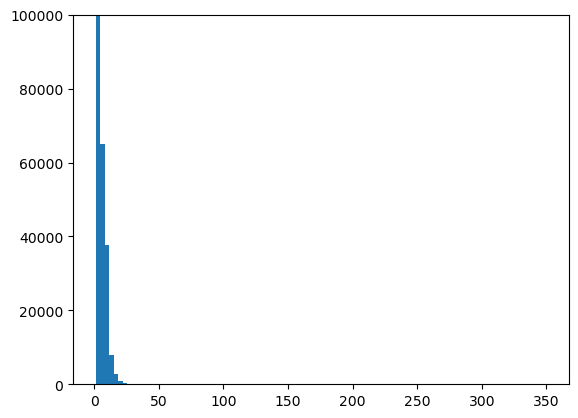

In [159]:
plt.hist(df.Cnt_thick.values, bins=100)
plt.ylim(0, 1e5)
plt.show()

In [11]:
# df = df[df.Cnt_thick > 1]
# df

In [12]:
coords = df.get_coordinates()
df['x'] = coords.x
df['y'] = coords.y

df.head()

,Mean_thick,Med_thick,SD_thick,Cnt_thick,IQR_thick,STE_thick,Min_thick,Max_thick,Mean_surf,Med_surf,...,SD_bed,Cnt_bed,IQR_bed,STE_bed,Min_bed,Max_bed,Mean_dist,geometry,x,y
0,2628,2628,-9999,1,0,-9999,2628,2628,-9999,-9999,...,-9999,0,-9999,-9999,-9999,-9999,332,POINT (121750 1565750),121750.0,1565750.0
1,2628,2628,11,2,8,7,2620,2635,-9999,-9999,...,-9999,0,-9999,-9999,-9999,-9999,154,POINT (121250 1565750),121250.0,1565750.0
2,2654,2654,12,2,8,8,2646,2663,-9999,-9999,...,-9999,0,-9999,-9999,-9999,-9999,219,POINT (120750 1566250),120750.0,1566250.0
3,2684,2684,8,2,6,5,2678,2690,-9999,-9999,...,-9999,0,-9999,-9999,-9999,-9999,155,POINT (120250 1566250),120250.0,1566250.0
4,2805,2803,8,3,8,4,2798,2814,-9999,-9999,...,-9999,0,-9999,-9999,-9999,-9999,146,POINT (118250 1567750),118250.0,1567750.0


In [ ]:
df2 = 

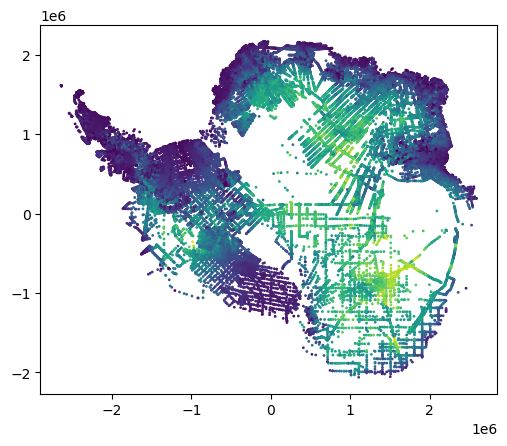

In [13]:
plt.scatter(df.x[::10], df.y[::10], c=df.Mean_thick[::10], s=1)
plt.axis('scaled')
plt.show()

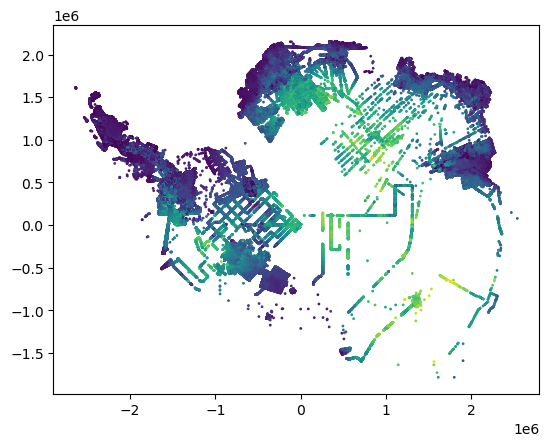

In [9]:
plt.scatter(df.x, df.y, c=df.Mean_thick, s=1)
plt.axis('scaled')
plt.show()

# Custom Bessel function

### modified Bessel function of the first kind

$$ I_v(x) = \left(\frac{x}{2}\right)^v\sum_{k=0}^{\infty}\frac{1}{k!\Gamma(v+k+1)}\left(\frac{x}{2}\right)^{2k} $$

### modified Bessel function of the second kind

$$ K_v(x) = \frac{\pi}{2} \frac{I_{-v}(x)-I_v(x)}{\sin \pi v} = K_{-v}(x) $$

In [139]:
from scipy.special import factorial, gamma, kv, iv
import math
from numba import njit, vectorize

def bessel_kv(v, x):
    # order cannot be whole number or else the sin returns 0
    if v==0:
        v += 0.01
        r = np.pi/2*(bessel_iv(-v, x) - bessel_iv(v, x))/np.sin(np.pi*v)
    # take the average around the whole number
    elif v%1 == 0:
        v1 = v-1e-6
        r1 = np.pi/2*(bessel_iv(-v1, x) - bessel_iv(v1, x))/np.sin(np.pi*v1)
        v2 = v+1e-6
        r2 = np.pi/2*(bessel_iv(-v2, x) - bessel_iv(v2, x))/np.sin(np.pi*v2)
        r = (r1+r2)/2
    else:
        r = np.pi/2*(bessel_iv(-v, x) - bessel_iv(v, x))/np.sin(np.pi*v)
    return r

def bessel_iv(v, x):
    s = 0
    for k in range(35):
        s += 1/(factorial(k)*math.gamma(v+k+1))*(x/2)**(2*k)
    return (x/2)**v*s

@njit
def bessel_kv_jit(v, x):
    # order cannot be whole number or else the sin returns 0
    if v==0:
        v += 0.01
        r = np.pi/2*(bessel_iv_jit(-v, x) - bessel_iv_jit(v, x))/np.sin(np.pi*v)
    # take the average around the whole number
    elif v%1 == 0:
        v1 = v-1e-6
        r1 = np.pi/2*(bessel_iv_jit(-v1, x) - bessel_iv_jit(v1, x))/np.sin(np.pi*v1)
        v2 = v+1e-6
        r2 = np.pi/2*(bessel_iv_jit(-v2, x) - bessel_iv_jit(v2, x))/np.sin(np.pi*v2)
        r = (r1+r2)/2
    else:
        r = np.pi/2*(bessel_iv_jit(-v, x) - bessel_iv_jit(v, x))/np.sin(np.pi*v)
    return r

# use math.gamma(k+1) because numba doesn't support factorial. works for arguments less than 135 or something
@vectorize
def bessel_iv_jit(v, x):
    s = 0
    for k in range(35):
        s += 1/(math.gamma(k+1)*math.gamma(v+k+1))*(x/2)**(2*k)
    return (x/2)**v*s

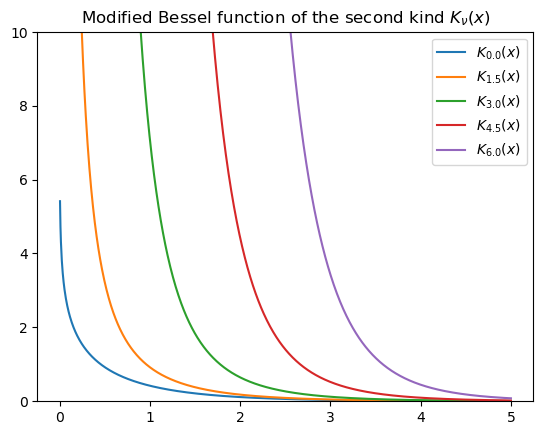

In [140]:
import numpy as np
from scipy.special import kv
import matplotlib.pyplot as plt
x = np.linspace(0, 5, 1000)
for N in np.linspace(0, 6, 5):
    plt.plot(x, kv(N, x), label='$K_{{{}}}(x)$'.format(N))
plt.ylim(0, 10)
plt.legend()
plt.title(r'Modified Bessel function of the second kind $K_\nu(x)$')
plt.show()

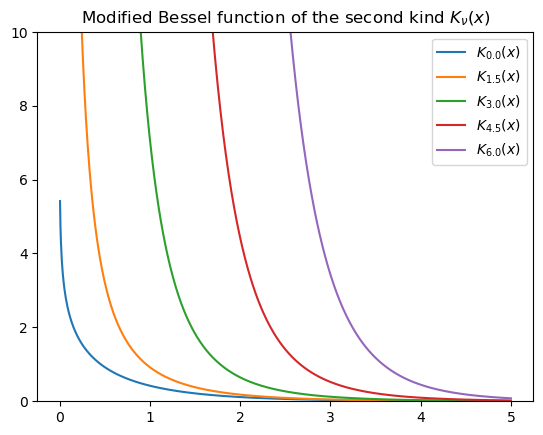

In [141]:
x = np.linspace(0, 5, 1000)
for N in np.linspace(0, 6, 5):
    plt.plot(x, bessel_kv_jit(N, x), label='$K_{{{}}}(x)$'.format(N))
plt.ylim(0, 10)
plt.legend()
plt.title(r'Modified Bessel function of the second kind $K_\nu(x)$')
plt.show()

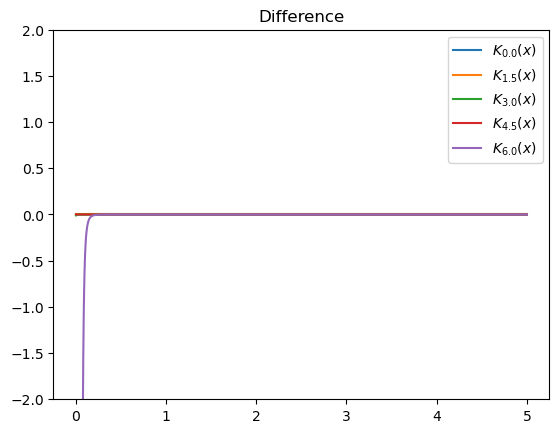

In [142]:
x = np.linspace(0, 5, 1000)
for N in np.linspace(0, 6, 5):
    plt.plot(x, kv(N, x)-bessel_kv_jit(N, x), label='$K_{{{}}}(x)$'.format(N))
plt.ylim(-2, 2)
plt.legend()
plt.title(r'Difference')
plt.show()

In [148]:
ss = np.linspace(0, 20, 100)
norm_ranges = np.linspace(0, 1, 100)
approx = np.full((len(ss),len(norm_ranges)), np.nan)
true = np.full((len(ss),len(norm_ranges)), np.nan)

for i, s in enumerate(ss):
    for j, norm_range in enumerate(norm_ranges):
        scale = 0.45246434*np.exp(-0.70449189*s)+1.7863836
        true[i,j] = kv(s, 2*scale*norm_range*np.sqrt(s))
        approx[i,j] = bessel_kv_jit(s, 2*scale*norm_range*np.sqrt(s))

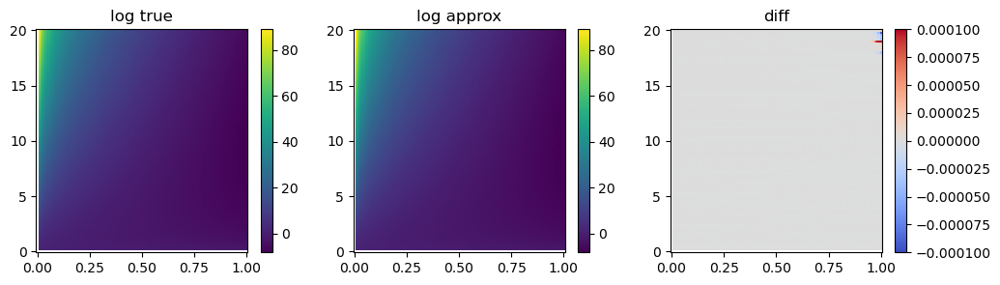

In [149]:
fig, axs = plt.subplots(1, 3, figsize=(12,3))
ax = axs[0]
im = ax.pcolormesh(norm_ranges, ss, np.log(true))
ax.set_title('log true')
plt.colorbar(im, ax=ax)

ax = axs[1]
im = ax.pcolormesh(norm_ranges, ss, np.log(approx))
ax.set_title('log approx')
plt.colorbar(im, ax=ax)

ax = axs[2]
im = ax.pcolormesh(norm_ranges, ss, np.log(true)-np.log(approx), vmin=-1e-4, vmax=1e-4, cmap='coolwarm')
ax.set_title('diff')
plt.colorbar(im, ax=ax)
plt.show()

In [145]:
def matern_custom(norm_range, sill, nugget, s, **kwargs):
    scale = 0.45246434*np.exp(-0.70449189*s)+1.7863836
    norm_range[norm_range==0.0] = 1e-8
    c = (sill-nugget)*2/gamma(s)*np.power(scale*norm_range*np.sqrt(s), s)*bessel_kv_jit(s, 2*scale*norm_range*np.sqrt(s))
    c[np.isnan(c)] = sill-nugget
    return c

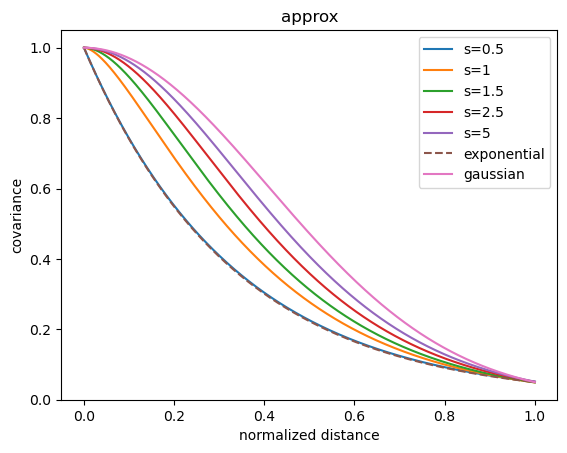

In [150]:
xi = np.linspace(0, 1, 1000)

y_exp = gsim.covariance.exponential_cov_norm(xi, 1, 0)
y_gau = gsim.covariance.gaussian_cov_norm(xi, 1, 0)

ss = [0.5, 1, 1.5, 2.5, 5]

for i, s in enumerate(ss):
    y = matern_custom(xi, sill=1.0, nugget=0, s=s)
    plt.plot(xi, y, '-', label=f's={s}')

plt.plot(xi, y_exp, '--', label='exponential')
plt.plot(xi, y_gau, label='gaussian')
plt.xlabel('normalized distance')
plt.ylabel('covariance')
plt.title('approx')
plt.ylim(0, 1.05)
plt.legend()
plt.show()

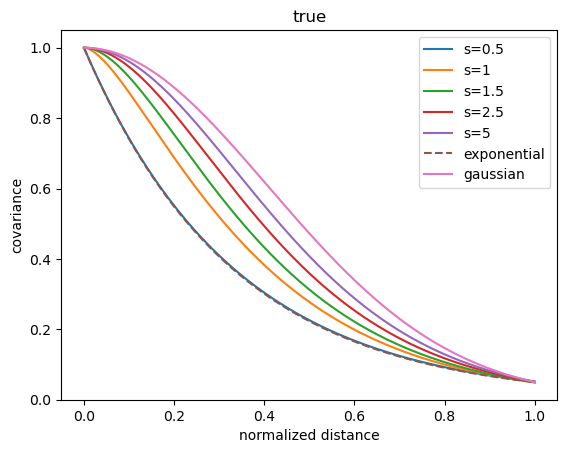

In [151]:
xi = np.linspace(0, 1, 1000)

y_exp = gsim.covariance.exponential_cov_norm(xi, 1, 0)
y_gau = gsim.covariance.gaussian_cov_norm(xi, 1, 0)

ss = [0.5, 1, 1.5, 2.5, 5]

for i, s in enumerate(ss):
    y = gsim.covariance.matern_cov_norm(xi, sill=1.0, nugget=0, s=s)
    plt.plot(xi, y, '-', label=f's={s}')

plt.plot(xi, y_exp, '--', label='exponential')
plt.plot(xi, y_gau, label='gaussian')
plt.xlabel('normalized distance')
plt.ylabel('covariance')
plt.title('true')
plt.ylim(0, 1.05)
plt.legend()
plt.show()

In [152]:
%%timeit

kv(0.5, 0.5)

825 ns ± 9.73 ns per loop (mean ± std. dev. of 7 runs, 1,000,000 loops each)


In [153]:
%%timeit

bessel_kv(0.5, 0.5)

606 μs ± 5.43 μs per loop (mean ± std. dev. of 7 runs, 1,000 loops each)


In [154]:
%%timeit

bessel_kv_jit(0.5, 0.5)

6.91 μs ± 20.4 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


In [3]:
rng = np.random.default_rng(0)
rng.integers(1e5, 1e6, size=1)

array([865561])

In [63]:
rename_dict = {
    'surface_altitude (m)' : 'surface',
    'land_ice_thickness (m)' : 'thickness',
    'bedrock_altitude (m)' : 'bed',
    'longitude (degree_east)' : 'lon',
    'latitude (degree_north)' : 'lat'
}

def collect_files(path, verbose=False):
    total = 0
    for item in os.scandir(path):
        if item.name.endswith('.csv'):
            total += 1
    
    dfs = []
    
    for i, item in tqdm(enumerate(os.scandir(path)), total=total):
        if item.name.endswith('.csv'):
            if verbose==True:
                print(item.path)
            dfs.append(pd.read_csv(item.path, header=18))

    if len(dfs)==1:
        df = dfs[0]
    else:
        df = pd.concat(dfs)
    df = df.rename(columns=rename_dict)
    df = df[['surface', 'thickness', 'bed', 'lat', 'lon']]
    df = df.replace(-9999, np.nan)
    
    return df

def geo2ant(lat, lon):
    """
    Converts geodetic coordinates to Antarctic Polar Stereographic

    Args:
        lat, lon : latitude and longitude arrays
    Outputs:
        x, y : coordinates in Antarctic Polar Stereographic
    """
    transformer = Transformer.from_crs(4326, 3031)
    x, y = transformer.transform(lat, lon)
    return x, y

In [64]:
bm1path = Path('D:/bedmap/BEDMAP1')
bm2path = Path('D:/bedmap/BEDMAP2')
bm3path = Path('D:/bedmap/BEDMAP3')
bmgrid_path = Path('D:/bedmap/bedmap3.nc')
bmach_path = Path('D:/bedmachine/BedMachineAntarctica-v3.nc')
stream_path = Path('D:/bedmap/bm3_streamlines_pt/bm3_streamlines_pt.shp')

print('collecting files')
bm1 = collect_files(bm1path)
bm2 = collect_files(bm2path)
bm3 = collect_files(bm3path)

df = pd.concat([bm1, bm2, bm3])

collecting files


  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/66 [00:00<?, ?it/s]

  0%|          | 0/84 [00:00<?, ?it/s]

In [65]:
x_coords, y_coords = geo2ant(df['lat'], df['lon'])
df['x'] = x_coords
df['y'] = y_coords

msk = (df['thickness'].isna()==True) & (df['surface'].isna()==False) & (df['bed'].isna()==False)
df.loc[msk, 'thickness'] = df.loc[msk, 'surface'] - df.loc[msk, 'bed']

df = df.loc[df['thickness'].isna()==False]

In [113]:
# add new COLDEX data
coldex = pd.read_csv(Path('D:/bedmap/2023_Antarctica_BaslerMKB.csv'))

x_coords, y_coords = geo2ant(coldex['LAT'], coldex['LON'])
coldex['x'] = x_coords
coldex['y'] = y_coords

coldex = coldex.rename(columns={'LAT' : 'lat', 'LON' : 'lon', 'THICK' : 'thickness', 'SURFACE' : 'surface', 'BOTTOM' : 'bed'})
coldex = coldex[['surface', 'thickness', 'bed', 'lat', 'lon', 'x', 'y']]

df = pd.concat([df, coldex])

In [114]:
df.shape

(83491217, 7)

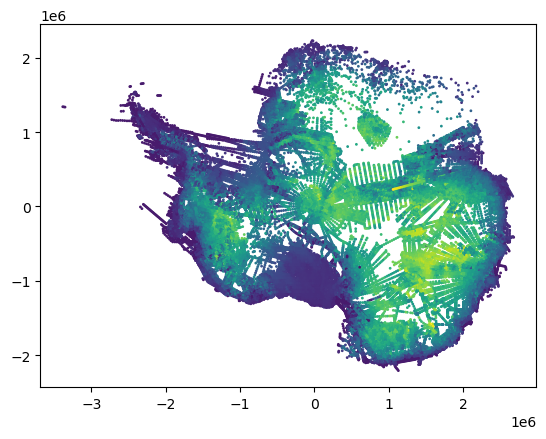

In [115]:
plt.scatter(df.x[::1000], df.y[::1000], c=df.thickness[::1000], s=1)
plt.axis('scaled')
plt.show()

In [116]:
ds = xr.open_dataset(Path('D:/bedmap/bedmap3.nc'))
#ds = ds.sel(x=slice(xmin, xmax), y=slice(ymax, ymin))
ds

<xarray.Dataset> Size: 5GB
Dimensions:                 (x: 13334, y: 13334)
Coordinates:
  * x                       (x) float32 53kB -3.333e+06 -3.333e+06 ... 3.333e+06
  * y                       (y) float32 53kB 3.333e+06 3.333e+06 ... -3.333e+06
Data variables:
    surface_topography      (y, x) float32 711MB ...
    bed_uncertainty         (y, x) float32 711MB ...
    bed_topography          (y, x) float32 711MB ...
    mask                    (y, x) float32 711MB ...
    ice_thickness           (y, x) float32 711MB ...
    thickness_survey_count  (y, x) float32 711MB ...
    thickness_uncertainty   (y, x) float32 711MB ...
    mapping                 <U19 76B ...
Attributes: (12/26)
    crs:                    EPSG:3031
    title:                  BEDMAP3 - Ice thickness, bed and surface elevatio...
    summary:                We present here Bedmap3, the latest suite of grid...
    keywords:               Antarctica,BEDMAP,Elevation,Ice thickness
    Conventions:            ACDD-1.3, CF-1.8
    citation:               Pritchard, H., Fretwell, P., Fremand, A., Bodart,...
    ...                     ...
    time_coverage_end:      2024-11-01
    geospatial_lon_min:     -180
    geospatial_lon_max:     180
    geospatial_lat_min:     -90
    geospatial_lat_max:     -60
    geospatial_bounds_crs:  EPSG:4326

In [117]:
xx, yy = np.meshgrid(ds.x, ds.y)

In [118]:
ds.x.values

array([-3333250., -3332750., -3332250., ...,  3332250.,  3332750.,
        3333250.], shape=(13334,), dtype=float32)

In [119]:
xbin_edges = ds.x.values - 250
xbin_edges = np.append(xbin_edges, ds.x.values[-1]+250)

ybin_edges = ds.y.values - 250
ybin_edges = np.append(ybin_edges, ds.y.values[-1]-750)

xbin_edges.size, ybin_edges.size

(13335, 13335)

In [120]:
xbins = np.digitize(df.x.values, xbin_edges)

In [121]:
ybins = np.digitize(df.y.values, ybin_edges)

In [122]:
np.unique(xbins).size

10872

In [123]:
xbins.size

83491217

In [124]:
# counts = np.zeros(xx.shape)

# for xbin in tqdm(np.unique(xbins)):
#     for ybin in np.unique(ybins):
#         counts[ybin,xbin] = np.count_nonzero((xbins==xbin) & (ybins==ybin))

In [198]:
from numba import njit, prange
from numba_progress import ProgressBar

@njit(parallel=True)
def block_reduce_jit(xx, bins, thickness, rands, progress_proxy):
    
    counts = np.zeros(xx.shape)
    mean = np.full(xx.shape, np.nan)
    median = np.full(xx.shape, np.nan)
    stdev = np.full(xx.shape, np.nan)
    median_partial = np.full(xx.shape, np.nan)
    
    xb_uniq = np.unique(bins[:,0])
    yb_uniq = np.unique(bins[:,1])
    
    for i in prange(xb_uniq.size):
        xbin = xb_uniq[i]
        inds1 = bins[:,0]==xbin
        bins1 = bins[inds1,:]
        thick1 = thickness[inds1]
        rands1 = rands[inds1]
        for j in range(yb_uniq.size):
            ybin = yb_uniq[j]
            inds2 = bins1[:,1]==ybin
            thick2 = thick1[inds2]
            rands2 = rands1[inds2]
            
            count = thick2.size
            if count > 0:
                counts[ybin,xbin] = count
                mean[ybin,xbin] = np.mean(thick2)
                median[ybin,xbin] = np.nanquantile(thick2, 0.5)
                stdev[ybin,xbin] = np.std(thick2)
                if count > 1:
                    sample = thick2[rands2 > 0.5]
                    if sample.size==0:
                        median_partial[ybin,xbin] = np.nanquantile(thick2, 0.5)
                    else:
                        median_partial[ybin,xbin] = np.nanquantile(sample, 0.5)
                else:
                    median_partial[ybin,xbin] = thick2[0]
        progress_proxy.update(1)
        
    return (counts, mean, median, stdev, median_partial)

In [199]:
bins = np.stack([xbins, ybins]).T
thickness = df.thickness.values
rng = np.random.default_rng(0)
rands = rng.random(size=thickness.size)

with ProgressBar(total=np.unique(xbins).size) as progress:
    result = block_reduce_jit(xx, bins, thickness, rands, progress)

  0%|          | 0/10872 [00:00<?, ?it/s]

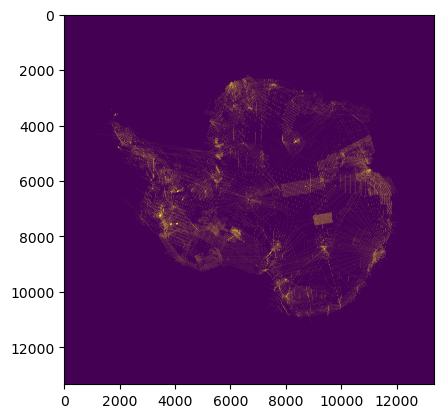

In [200]:
counts = result[0]

plt.imshow(counts>0)
plt.show()

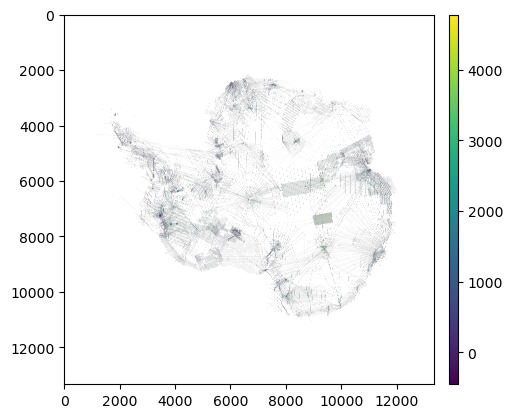

In [201]:
mean = result[1]

plt.imshow(mean)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

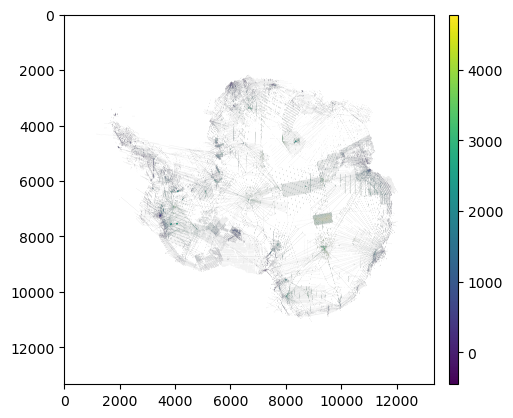

In [202]:
median = result[2]

plt.imshow(median)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

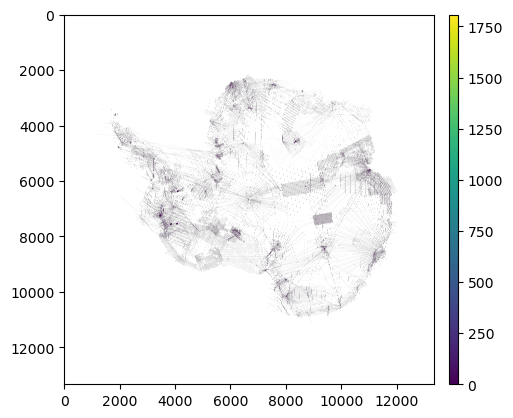

In [203]:
stdev = result[3]

plt.imshow(stdev)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

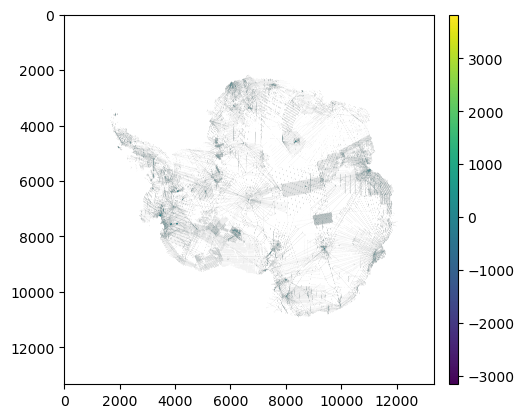

In [204]:
plt.imshow(ds.ice_thickness.values-median)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

In [205]:
x_bad = xx[stdev>300]
y_bad = yy[stdev>300]
mean_bad = mean[stdev>300]
median_bad = median[stdev>300]

In [206]:
x_bad.size

4974

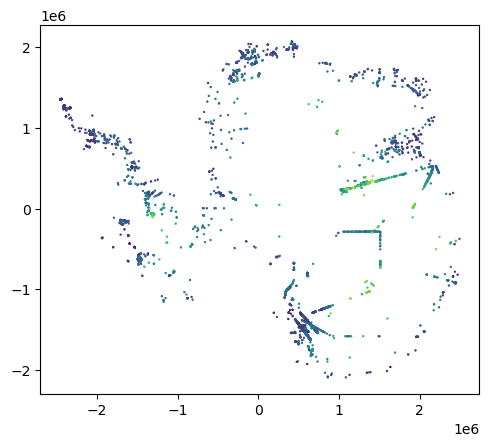

In [207]:
plt.scatter(x_bad, y_bad, c=mean_bad, s=0.5)
plt.axis('scaled')
plt.show()

In [208]:
diff = np.abs(ds.ice_thickness.values-median)

bad_val = 300

x_bad = xx[diff>bad_val]
y_bad = yy[diff>bad_val]
mean_bad = mean[diff>bad_val]
median_bad = median[diff>bad_val]

In [209]:
x_bad.size

61355

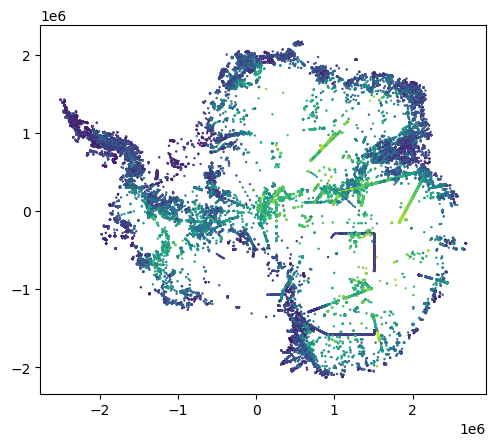

In [210]:
plt.scatter(x_bad, y_bad, c=median_bad, s=0.5)
plt.axis('scaled')
plt.show()

In [211]:
bad_msk = (stdev>300) | (np.abs(ds.ice_thickness.values-median)>300)
x_bad = xx[bad_msk]
y_bad = yy[bad_msk]

print(f'{x_bad.size} bad points, {x_bad.size/np.count_nonzero(counts>0)*100:.2f}% of conditioning data')

64448 bad points, 1.63% of conditioning data


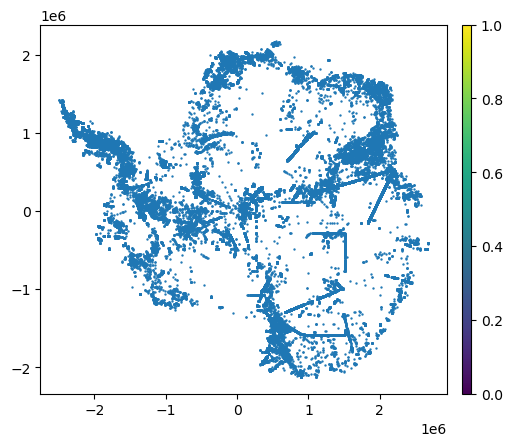

In [212]:
plt.scatter(x_bad, y_bad, s=0.5)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

In [213]:
thick_cond = np.where(bad_msk, np.nan, median)

In [214]:
np.count_nonzero(~np.isnan(median)), np.count_nonzero(~np.isnan(thick_cond))

(3941775, 3877327)

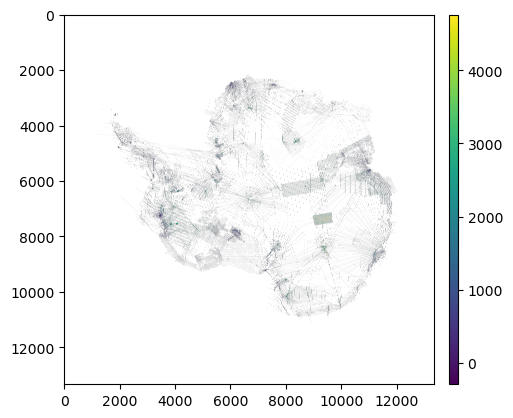

In [215]:
plt.imshow(thick_cond)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

In [216]:
ice_rock_msk = (ds.mask == 1) | (ds.mask == 2)
print(f'{np.count_nonzero(np.isnan(thick_cond) & ice_rock_msk):,} grid cells to simulate at 500 m resolution')

44,824,298 grid cells to simulate at 500 m resolution


In [217]:
ilow = 10000
ihigh = 10500
jlow = 8000
jhigh = 8500

thick_cond_trim = thick_cond[ilow:ihigh,jlow:jhigh]
std_trim = stdev[ilow:ihigh,jlow:jhigh]
counts_trim = counts[ilow:ihigh,jlow:jhigh]

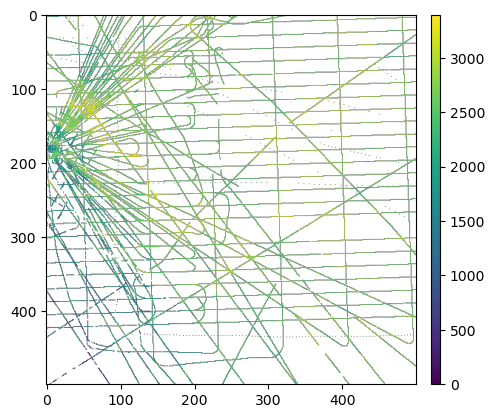

In [218]:
plt.imshow(thick_cond_trim)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

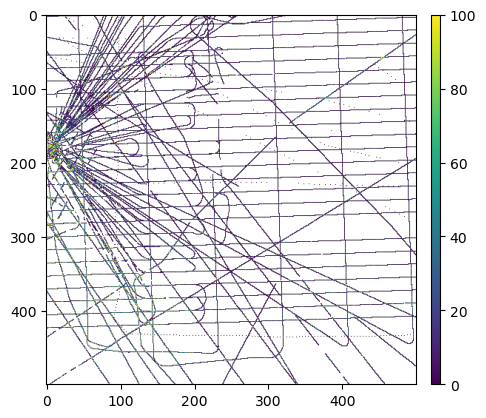

In [219]:
plt.imshow(std_trim, vmax=100)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

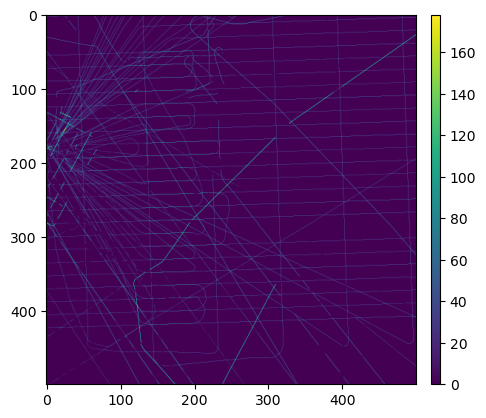

In [220]:
plt.imshow(counts_trim)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

In [221]:
rng = np.random.default_rng(0)

mean_cond = mean[~np.isnan(mean)]
std_cond = stdev[~np.isnan(stdev)]

mean_cond.size, std_cond.size

(3941775, 3941775)

In [222]:
sample = rng.normal(mean, stdev)

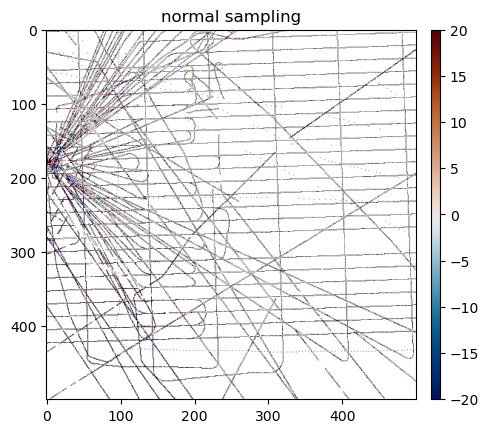

In [230]:
mean_trim = mean[ilow:ihigh,jlow:jhigh]
sample_trim = sample[ilow:ihigh,jlow:jhigh]

plt.imshow(mean_trim-sample_trim, vmin=-20, vmax=20, cmap=cm.vik)
plt.colorbar(pad=0.03, aspect=40)
plt.title('normal sampling')
plt.show()

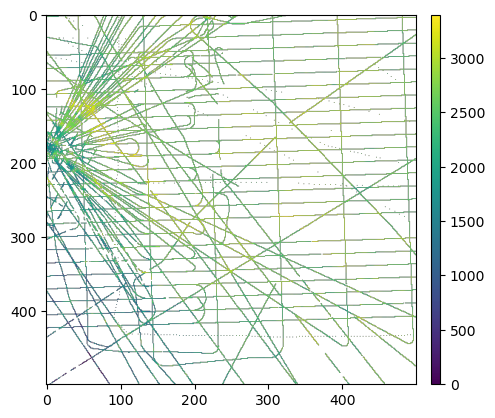

In [225]:
partial = result[4]
partial_trim = partial[ilow:ihigh,jlow:jhigh]

plt.imshow(partial_trim)
plt.colorbar(pad=0.03, aspect=40)
plt.show()

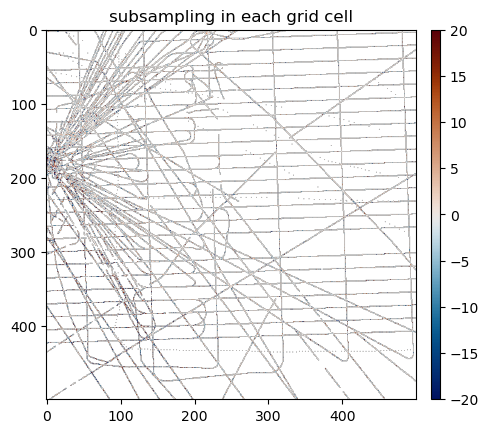

In [231]:
median_trim = median[ilow:ihigh,jlow:jhigh]

plt.imshow(median_trim-partial_trim, vmin=-20, vmax=20, cmap=cm.vik)
plt.colorbar(pad=0.03, aspect=40)
plt.title('subsampling in each grid cell')
plt.show()

In [232]:
np.max(counts)

np.float64(4425.0)

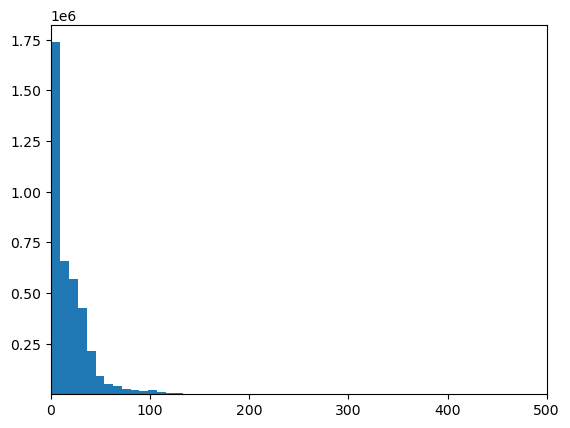

In [233]:
plt.hist(counts[counts>0], bins=500)
plt.xlim(0,500)
plt.ylim(1000)
plt.show()

In [194]:
def block_reduce(xx, bins, thickness):
    
    counts = np.zeros(xx.shape)
    mean = np.full(xx.shape, np.nan)
    median = np.full(xx.shape, np.nan)
    stdev = np.full(xx.shape, np.nan)
    median_partial = np.full(xx.shape, np.nan)
    
    xb_uniq = np.unique(bins[:,0])
    yb_uniq = np.unique(bins[:,1])
    
    for i in tqdm(range(xb_uniq.size)):
        xbin = xb_uniq[i]
        bins1 = bins[bins[:,0]==xbin,:]
        thick1 = thickness[bins[:,0]==xbin]
        for j in range(yb_uniq.size):
            ybin = yb_uniq[j]
            thick2 = thick1[bins1[:,1]==ybin]
            count = thick2.size
            if count > 0:
                counts[ybin,xbin] = count
                mean[ybin,xbin] = np.mean(thick2)
                median[ybin,xbin] = np.nanquantile(thick2, 0.5)
                stdev[ybin,xbin] = np.std(thick2)
                # rng = np.random.default_rng()
                if count > 1:
                    median_partial[ybin,xbin] = np.nanquantile(thick2[rng.integers(0, 2, size=thick2.size)==1], 0.5)
                else:
                    median_partial[ybin,xbin] = thick2[0]
        
    return (counts, mean, median, stdev, median_partial)

In [195]:
result2 = block_reduce(xx, bins, thickness)

  0%|          | 0/10872 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [179]:
ints = rng.integers(0, 2, size=1000)

In [182]:
rands = rng.random(size=1000)

In [183]:
np.count_nonzero(ints==0)

499

In [185]:
rands[ints==1].size

501

In [11]:
ds = xr.open_dataset(Path('processed_data/bedmap3_mod_500.nc'))

# exposed_rock_cond = np.full(ds.thick_cond.shape, np.nan)
# exposed_rock_cond[ds.mask == 4] = True
thick_cond = np.where(ds.mask == 4, 0, ds.thick_cond.values)
#ground_ice_msk = ds.mask==1

bed_cond = ds.surface_topography.values - thick_cond
ice_rock_msk = (ds.mask == 1) | (ds.mask == 4) | (ds.mask == 2)
bed_cond = np.where(ice_rock_msk, bed_cond, np.nan)
xx, yy = np.meshgrid(ds.x, ds.y)

cond_msk = ~np.isnan(bed_cond)
#cond_msk = np.where(
x_cond = xx[cond_msk]
y_cond = yy[cond_msk]
data_cond = bed_cond[cond_msk]
trend = ds.trend.values

res_cond = bed_cond - trend

In [12]:
ds

<xarray.Dataset> Size: 11GB
Dimensions:                 (x: 13334, y: 13334)
Coordinates:
  * x                       (x) float32 53kB -3.333e+06 -3.333e+06 ... 3.333e+06
  * y                       (y) float32 53kB 3.333e+06 3.333e+06 ... -3.333e+06
Data variables:
    surface_topography      (y, x) float32 711MB nan nan nan nan ... nan nan nan
    bed_uncertainty         (y, x) float32 711MB ...
    bed_topography          (y, x) float32 711MB ...
    mask                    (y, x) float32 711MB nan nan nan nan ... nan nan nan
    ice_thickness           (y, x) float32 711MB ...
    thickness_survey_count  (y, x) float32 711MB ...
    thickness_uncertainty   (y, x) float32 711MB ...
    mapping                 <U19 76B ...
    geoid                   (y, x) float64 1GB ...
    thick_cond              (y, x) float64 1GB nan nan nan nan ... nan nan nan
    stream_thick            (y, x) float64 1GB ...
    trend                   (y, x) float64 1GB nan nan nan nan ... nan nan nan
Attributes: (12/26)
    crs:                    EPSG:3031
    title:                  BEDMAP3 - Ice thickness, bed and surface elevatio...
    summary:                We present here Bedmap3, the latest suite of grid...
    keywords:               Antarctica,BEDMAP,Elevation,Ice thickness
    Conventions:            ACDD-1.3, CF-1.8
    citation:               Pritchard, H., Fretwell, P., Fremand, A., Bodart,...
    ...                     ...
    time_coverage_end:      2024-11-01
    geospatial_lon_min:     -180
    geospatial_lon_max:     180
    geospatial_lat_min:     -90
    geospatial_lat_max:     -60
    geospatial_bounds_crs:  EPSG:4326

In [13]:
ilow = 10000
ihigh = 10500
jlow = 8000
jhigh = 8500

bed_cond_trim = bed_cond[ilow:ihigh,jlow:jhigh]

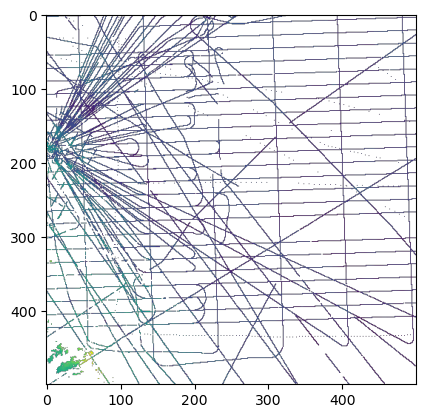

In [14]:
plt.imshow(bed_cond_trim)
plt.show()

In [19]:
ilow = 8000
ihigh = 9000
jlow = 8500
jhigh = 9500

x_trim_km = ds.x.values[ilow:ihigh]/1000
y_trim_km = ds.y.values[jlow:jhigh]/1000
bed_cond_trim = bed_cond[ilow:ihigh,jlow:jhigh]
bed_trim = ds.bed_topography.values[ilow:ihigh,jlow:jhigh]

sim = np.load(Path('results/nonstationary_sim_500.npy'))
sim_trim = sim[ilow:ihigh,jlow:jhigh] + ds.trend.values[ilow:ihigh,jlow:jhigh]

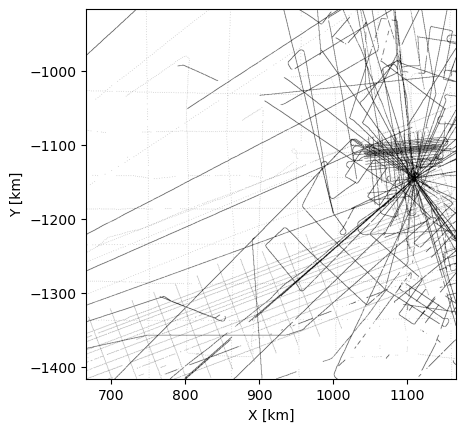

In [17]:
extent = [x_trim_km.min(), x_trim_km.max(), y_trim_km.min(), y_trim_km.max()]

plt.imshow(np.isnan(bed_cond_trim), extent=extent, cmap='binary_r')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.savefig(Path('figures/cond_example.png'), dpi=300, bbox_inches='tight')
plt.show()

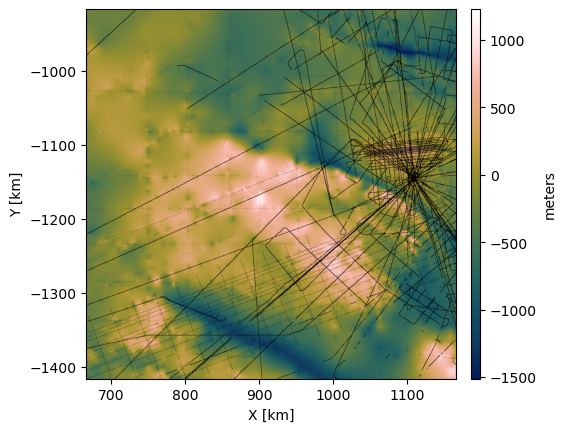

In [18]:
im = plt.imshow(bed_trim, extent=extent, cmap=cm.batlowW)
plt.imshow(np.where(np.isnan(bed_cond_trim)==True, np.nan, 1), extent=extent, cmap='binary_r', alpha=1)
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.colorbar(im, pad=0.03, aspect=40, label='meters')
plt.savefig(Path('figures/cond_bed_example.png'), dpi=300, bbox_inches='tight')
plt.show()

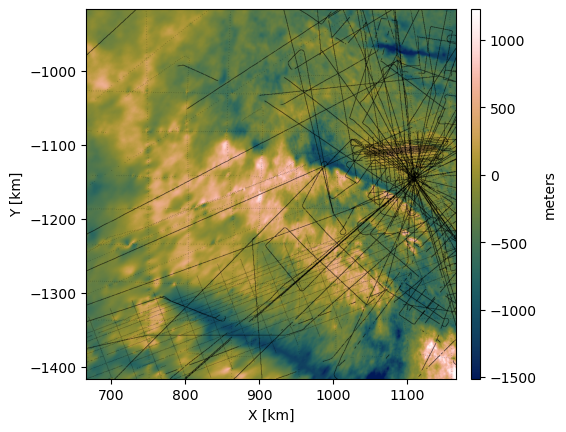

In [22]:
im = plt.imshow(sim_trim, extent=extent, cmap=cm.batlowW, vmin=np.min(bed_trim), vmax=np.max(bed_trim))
plt.imshow(np.where(np.isnan(bed_cond_trim)==True, np.nan, 1), extent=extent, cmap='binary_r', alpha=1)
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.colorbar(im, pad=0.03, aspect=40, label='meters')
plt.savefig(Path('figures/cond_sim_example.png'), dpi=300, bbox_inches='tight')
plt.show()

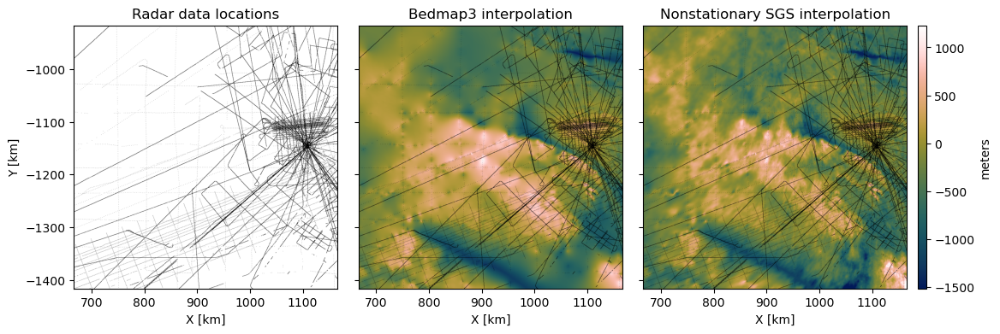

In [42]:
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(13,4), constrained_layout=True)
gspec = GridSpec(1, 4, width_ratios=[1, 1, 1, 0.03], wspace=0.0)
axs = []
for i in range(3):
    axs.append(fig.add_subplot(gspec[0,i]))
    
ax = axs[0]
ax.imshow(np.isnan(bed_cond_trim), extent=extent, cmap='binary_r')
ax.set_xlabel('X [km]')
ax.set_ylabel('Y [km]')
ax.set_title('Radar data locations')

ax = axs[1]
im = ax.imshow(bed_trim, extent=extent, cmap=cm.batlowW)
ax.imshow(np.where(np.isnan(bed_cond_trim)==True, np.nan, 1), extent=extent, cmap='binary_r', alpha=1)
ax.set_xlabel('X [km]')
ax.set_yticklabels([])
ax.set_title('Bedmap3 interpolation')

ax = axs[2]
im = ax.imshow(sim_trim, extent=extent, cmap=cm.batlowW, vmin=np.min(bed_trim), vmax=np.max(bed_trim))
ax.imshow(np.where(np.isnan(bed_cond_trim)==True, np.nan, 1), extent=extent, cmap='binary_r', alpha=1)
ax.set_xlabel('X [km]')
ax.set_yticklabels([])
ax.set_title('Nonstationary SGS interpolation')

cax = fig.add_subplot(gspec[0,3])
plt.colorbar(im, cax=cax, label='meters')
plt.savefig(Path('figures/radar_bm3_sim.png'), dpi=300, bbox_inches='tight')
plt.show()

In [33]:
from matplotlib.patches import Rectangle

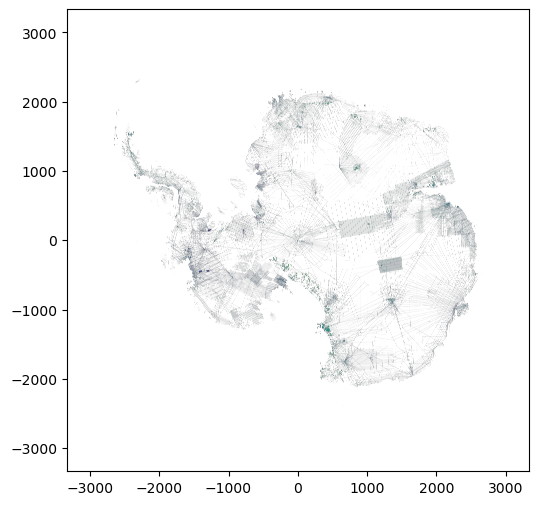

In [40]:
extent_big = [ds.x.values.min()/1000, ds.x.values.max()/1000, ds.y.values.min()/1000, ds.y.values.max()/1000]

fig, ax = plt.subplots(1, 1, figsize=(6,6))
ax.imshow(bed_cond, extent=extent_big)
ax.add_patch(Rectangle((x_trim_km.min(), y_trim_km.min()), x_trim_km.max()-x_trim_km.min(), y_trim_km.max()-y_trim_km.min(), ec='r', lw=2, fc='none'))
plt.show()